# data preprocessing and crafting down the filters

In [ ]:
#mounting the google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#installing the dependencies
import numpy as np
import torch
import torchvision.transforms as T
from PIL import Image
import os
import cv2
import json
import glob
from tqdm.notebook import tqdm

## importing dinov2 from facebook reasearch repo

In [ ]:
!pip install roboflow supervision -q

In [ ]:
dinov2_vits14 = torch.hub.load("facebookresearch/dinov2", "dinov2_vits14")

device = torch.device('cuda' if torch.cuda.is_available() else "cpu")

dinov2_vits14.to(device)

Using cache found in /root/.cache/torch/hub/facebookresearch_dinov2_main


DinoVisionTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 384, kernel_size=(14, 14), stride=(14, 14))
    (norm): Identity()
  )
  (blocks): ModuleList(
    (0-11): 12 x NestedTensorBlock(
      (norm1): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
      (attn): MemEffAttention(
        (qkv): Linear(in_features=384, out_features=1152, bias=True)
        (proj): Linear(in_features=384, out_features=384, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): LayerScale()
      (drop_path1): Identity()
      (norm2): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=384, out_features=1536, bias=True)
        (act): GELU(approximate='none')
        (fc2): Linear(in_features=1536, out_features=384, bias=True)
        (drop): Dropout(p=0.0, inplace=False)
      )
      (ls2): LayerScale()
      (drop_path2): Identity()
    )
  )
  (norm): LayerNorm((384,), eps=1e-06, elementwise_affi

## dummy input test

In [ ]:
# dummy image input
import torch
from torchvision import transforms
from PIL import Image
import requests

# Check dummy input
dummy = torch.randn(1, 3, 518, 518).to(device)
with torch.no_grad():
    out_dummy = dinov2_vits14(dummy)
print("✅ Dummy input output shape:", out_dummy.shape)

# Now test with real image
url = "https://picsum.photos/200/300"
img = Image.open(requests.get(url, stream=True).raw).convert("RGB")

transform = transforms.Compose([
    transforms.Resize((518, 518)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])

img_tensor = transform(img).unsqueeze(0).to(device)
with torch.no_grad():
    out_real = dinov2_vits14(img_tensor)
print("✅ Real image output shape:", out_real.shape)


✅ Dummy input output shape: torch.Size([1, 384])
✅ Real image output shape: torch.Size([1, 384])


### importing dristhi-gs , creating segment mask upon cup and disc for segmentation training on our pretrained unet-effecientnetb4 model

In [ ]:
import kagglehub
import os

# Step 1: Download and extract the dataset
path = kagglehub.dataset_download("lokeshsaipureddi/drishtigs-retina-dataset-for-onh-segmentation")

# path is a directory, not a zip file
print("Dataset root path:", path)

# Step 2: Locate useful subdirectories
train_dir = os.path.join(path, "Training-20211018T055246Z-001", "Training")
train_images_dir = os.path.join(train_dir, "Images")
train_gt_dir = os.path.join(train_dir, "GT")

print("Train images:", train_images_dir)
print("Ground truth:", train_gt_dir)

# Step 3: Example - list a few images and ground truth folders
print("\nSample images:", os.listdir(train_images_dir)[:5])
print("Sample GT folders:", os.listdir(train_gt_dir)[:5])


Dataset root path: /kaggle/input/drishtigs-retina-dataset-for-onh-segmentation
Train images: /kaggle/input/drishtigs-retina-dataset-for-onh-segmentation/Training-20211018T055246Z-001/Training/Images
Ground truth: /kaggle/input/drishtigs-retina-dataset-for-onh-segmentation/Training-20211018T055246Z-001/Training/GT

Sample images: ['GLAUCOMA', 'NORMAL']
Sample GT folders: ['drishtiGS_058', 'Notching___Image__level_decisions.xlsx', 'drishtiGS_032', 'drishtiGS_042', 'drishtiGS_075']


In [ ]:
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt

# Directories
# Use the `path` variable obtained from kagglehub.dataset_download
GT_ROOT = os.path.join(path, "Training-20211018T055246Z-001", "Training", "GT")
IMG_ROOT = os.path.join(path, "Training-20211018T055246Z-001", "Training", "Images")


# Output for sanity
OUTPUT_MASK_DIR = "/kaggle/working/masks"
os.makedirs(OUTPUT_MASK_DIR, exist_ok=True)

def load_boundary(txt_path):
    """Load polygon boundary from .txt file."""
    coords = []
    with open(txt_path, 'r') as f:
        for line in f:
            x, y = line.strip().split()
            coords.append([int(float(x)), int(float(y))])
    return np.array(coords, dtype=np.int32)

def create_mask(image_shape, boundary_coords):
    """Return binary mask from polygon."""
    mask = np.zeros(image_shape[:2], dtype=np.uint8)
    cv2.fillPoly(mask, [boundary_coords], color=255)
    return mask

# Process a few GT samples
for gt_id in os.listdir(GT_ROOT):
    if not gt_id.startswith("drishtiGS_"):
        continue

    avg_boundary_dir = os.path.join(GT_ROOT, gt_id, "AvgBoundary")

    try:
        disc_path = os.path.join(avg_boundary_dir, f"{gt_id}_ODAvgBoundary.txt")
        cup_path  = os.path.join(avg_boundary_dir, f"{gt_id}_CupAvgBoundary.txt")

        # Load boundaries
        disc_coords = load_boundary(disc_path)
        cup_coords  = load_boundary(cup_path)

        # Load corresponding fundus image (GLAUCOMA or NORMAL class, check both)
        image_found = False
        for cls in ["GLAUCOMA", "NORMAL"]:
            img_path = os.path.join(IMG_ROOT, cls, f"{gt_id}.png")
            if os.path.exists(img_path):
                img = cv2.imread(img_path)
                image_found = True
                break

        if not image_found:
            print(f"Image not found for ID {gt_id}")
            continue

        # Create masks
        disc_mask = create_mask(img.shape, disc_coords)
        cup_mask = create_mask(img.shape, cup_coords)

        # Save masks (optional)
        cv2.imwrite(os.path.join(OUTPUT_MASK_DIR, f"{gt_id}_disc_mask.png"), disc_mask)
        cv2.imwrite(os.path.join(OUTPUT_MASK_DIR, f"{gt_id}_cup_mask.png"), cup_mask)

        print(f"✅ Mask created for {gt_id}")

    except Exception as e:
        print(f"❌ Error processing {gt_id}: {e}")

✅ Mask created for drishtiGS_058
✅ Mask created for drishtiGS_032
✅ Mask created for drishtiGS_042
✅ Mask created for drishtiGS_075
✅ Mask created for drishtiGS_017
✅ Mask created for drishtiGS_080
✅ Mask created for drishtiGS_046
✅ Mask created for drishtiGS_089
✅ Mask created for drishtiGS_016
✅ Mask created for drishtiGS_040
✅ Mask created for drishtiGS_094
✅ Mask created for drishtiGS_062
✅ Mask created for drishtiGS_044
✅ Mask created for drishtiGS_022
✅ Mask created for drishtiGS_069
✅ Mask created for drishtiGS_088
✅ Mask created for drishtiGS_098
✅ Mask created for drishtiGS_024
✅ Mask created for drishtiGS_049
✅ Mask created for drishtiGS_084
✅ Mask created for drishtiGS_047
✅ Mask created for drishtiGS_060
✅ Mask created for drishtiGS_036
✅ Mask created for drishtiGS_061
✅ Mask created for drishtiGS_066
✅ Mask created for drishtiGS_033
✅ Mask created for drishtiGS_045
✅ Mask created for drishtiGS_064
✅ Mask created for drishtiGS_018
✅ Mask created for drishtiGS_038
✅ Mask cre

In [ ]:
import os

# Update image_dir and gt_dir to use the 'path' variable
# This ensures they point to the location where kagglehub downloaded the dataset
image_dir = os.path.join(path, "Training-20211018T055246Z-001", "Training", "Images")
gt_dir = os.path.join(path, "Training-20211018T055246Z-001", "Training", "GT")


for cls in ["GLAUCOMA", "NORMAL"]:
    cls_dir = os.path.join(image_dir, cls)
    print(f"\nClass: {cls}")
    # Check if the directory exists before listing its contents
    if os.path.exists(cls_dir):
        print(os.listdir(cls_dir)[:5])  # print only a few
    else:
        print(f"Directory not found: {cls_dir}")


Class: GLAUCOMA
['drishtiGS_068.png', 'drishtiGS_045.png', 'drishtiGS_044.png', 'drishtiGS_004.png', 'drishtiGS_040.png']

Class: NORMAL
['drishtiGS_042.png', 'drishtiGS_094.png', 'drishtiGS_035.png', 'drishtiGS_018.png', 'drishtiGS_090.png']


In [ ]:
import os
import cv2
import torch
from torch.utils.data import Dataset
import numpy as np
from torchvision import transforms

class DrishtiGSDataset(Dataset):
    def __init__(self, image_dir, gt_dir, transform=None, mask_size=(512, 512)):
        self.image_dir = image_dir
        self.gt_dir = gt_dir
        self.transform = transform
        self.mask_size = mask_size
        self.samples = []

        glaucoma_dir = os.path.join(image_dir, "GLAUCOMA")
        normal_dir = os.path.join(image_dir, "NORMAL")
        all_images = {
            os.path.splitext(f)[0].lower(): os.path.join(glaucoma_dir, f)
            for f in os.listdir(glaucoma_dir)
        }
        all_images.update({
            os.path.splitext(f)[0].lower(): os.path.join(normal_dir, f)
            for f in os.listdir(normal_dir)
        })

        gt_ids = [d for d in os.listdir(gt_dir) if os.path.isdir(os.path.join(gt_dir, d))]
        for gid in gt_ids:
            gid_lower = gid.lower()
            if gid_lower in all_images:
                img_path = all_images[gid_lower]
                cup_mask = os.path.join(gt_dir, gid, "SoftMap", f"{gid}_cupsegSoftmap.png")
                disc_mask = os.path.join(gt_dir, gid, "SoftMap", f"{gid}_ODsegSoftmap.png")
                if os.path.exists(cup_mask) and os.path.exists(disc_mask):
                    self.samples.append({
                        "image": img_path,
                        "cup_mask": cup_mask,
                        "disc_mask": disc_mask
                    })
                else:
                    print(f"❌ Missing mask(s) for {gid}")
            else:
                print(f"❌ Image not found for {gid}")

        print(f"✅ Total valid image-mask pairs: {len(self.samples)}")

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        sample = self.samples[idx]
        img = cv2.imread(sample["image"])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, self.mask_size)

        cup = cv2.imread(sample["cup_mask"], cv2.IMREAD_GRAYSCALE)
        disc = cv2.imread(sample["disc_mask"], cv2.IMREAD_GRAYSCALE)

        cup = cv2.resize(cup, self.mask_size)
        disc = cv2.resize(disc, self.mask_size)

        # Normalize masks
        cup = (cup > 10).astype(np.float32)  # threshold softmaps
        disc = (disc > 10).astype(np.float32)

        mask = np.stack([disc, cup], axis=0)  # [2, H, W]

        if self.transform:
            img = self.transform(img)

        else:
            img = transforms.ToTensor()(img)

        return img, torch.tensor(mask, dtype=torch.float32)


In [ ]:
# Reuse the 'path' variable from the kagglehub download
# image_dir = "/kaggle/input/drishtigs-retina-dataset-for-onh-segmentation/Training-20211018T055246Z-001/Training/Images"
# gt_dir = "/kaggle/input/drishtigs-retina-dataset-for-onh-segmentation/Training-20211018T055246Z-001/Training/GT"

# Construct paths using the 'path' variable
image_dir = os.path.join(path, "Training-20211018T055246Z-001", "Training", "Images")
gt_dir = os.path.join(path, "Training-20211018T055246Z-001", "Training", "GT")


dataset = DrishtiGSDataset(image_dir=image_dir, gt_dir=gt_dir)

print("Dataset size:", len(dataset))
img, mask = dataset[0]
print("Image shape:", img.shape)
print("Mask shape:", mask.shape)

✅ Total valid image-mask pairs: 50
Dataset size: 50
Image shape: torch.Size([3, 512, 512])
Mask shape: torch.Size([2, 512, 512])


In [ ]:
import os
import numpy as np
from skimage.measure import label, regionprops
from tqdm import tqdm

# Thresholds
MIN_DISC_HEIGHT = 50
MIN_DISC_AREA = 500
MIN_CDR = 0.1
MAX_CDR = 1.2

valid_indices = []
invalid_indices = []

def compute_vertical_extent(mask):
    labeled = label(mask)
    props = regionprops(labeled)
    if not props:
        return 0
    return max([p.bbox[2] - p.bbox[0] for p in props])  # max height

def compute_area(mask):
    return np.sum(mask)

# Process in chunks to reduce memory spikes
for idx in tqdm(range(len(dataset)), desc="Filtering OD/OC masks"):
    try:
        _, mask = dataset[idx]
        disc_mask = mask[0].numpy().astype(np.uint8)
        cup_mask = mask[1].numpy().astype(np.uint8)

        disc_height = compute_vertical_extent(disc_mask)
        cup_height = compute_vertical_extent(cup_mask)

        disc_area = compute_area(disc_mask)
        cup_area = compute_area(cup_mask)

        if disc_height >= MIN_DISC_HEIGHT and disc_area >= MIN_DISC_AREA:
            cdr = cup_height / disc_height if disc_height > 0 else 0
            if MIN_CDR <= cdr <= MAX_CDR:
                valid_indices.append(idx)
            else:
                invalid_indices.append(idx)
        else:
            invalid_indices.append(idx)

    except Exception as e:
        print(f"[!] Error at index {idx}: {e}")
        invalid_indices.append(idx)


Filtering OD/OC masks: 100%|██████████| 50/50 [00:06<00:00,  7.80it/s]


In [ ]:
np.save("valid_indices.npy", np.array(valid_indices))
np.save("invalid_indices.npy", np.array(invalid_indices))
valid_indices = np.load("valid_indices.npy").tolist()
filtered_dataset = torch.utils.data.Subset(dataset, valid_indices)

In [ ]:
!pip install torchmetrics
!pip install -q segmentation-models-pytorch

In [ ]:
from torchmetrics.classification import MulticlassJaccardIndex
import torch # Import torch if not already imported

DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

# For 2-class multilabel (OD + OC masks)
iou_metric = MulticlassJaccardIndex(num_classes=2, average='macro').to(DEVICE)

In [ ]:
def validate(model, val_loader):
    model.eval()
    iou_metric.reset()

    with torch.no_grad():
        for img, mask in val_loader:
            img, mask = img.to(DEVICE), mask.to(DEVICE)
            preds = model(img)

            # Convert preds to binary masks
            preds_bin = (preds > 0.5).int()
            mask_bin = mask.int()

            iou_metric.update(preds_bin, mask_bin)

    iou = iou_metric.compute().item()
    print(f"Validation IoU: {iou:.4f}")


## training loop

In [ ]:
import os
import cv2
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
import albumentations as A
from albumentations.pytorch import ToTensorV2
import segmentation_models_pytorch as smp
import torch.optim as optim
from tqdm import tqdm
from matplotlib import pyplot as plt

# ================= Dataset ==================
class DrishtiGSDataset(Dataset):
    def __init__(self, image_dir, gt_dir, transform=None):
        self.image_dir = image_dir
        self.gt_dir = gt_dir
        self.transform = transform
        self.samples = []

        for cls in ["GLAUCOMA", "NORMAL"]:
            img_dir = os.path.join(image_dir, cls)
            if not os.path.exists(img_dir):
                print(f"Warning: Image directory not found: {img_dir}")
                continue

            for img_name in os.listdir(img_dir):
                if img_name.endswith(".png"):
                    base_id = img_name.replace(".png", "")
                    mask_dir = os.path.join(gt_dir, base_id, "SoftMap")
                    od_path = os.path.join(mask_dir, f"{base_id}_ODsegSoftmap.png")
                    cup_path = os.path.join(mask_dir, f"{base_id}_cupsegSoftmap.png")
                    if os.path.exists(od_path) and os.path.exists(cup_path):
                        self.samples.append({
                            "img_path": os.path.join(img_dir, img_name),
                            "od_path": od_path,
                            "cup_path": cup_path
                        })

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        sample = self.samples[idx]
        img = cv2.imread(sample["img_path"])[..., ::-1]
        img = cv2.resize(img, (512, 512))

        od_mask = cv2.imread(sample["od_path"], 0)
        cup_mask = cv2.imread(sample["cup_path"], 0)
        od_mask = cv2.resize(od_mask, (512, 512)) / 255.0
        cup_mask = cv2.resize(cup_mask, (512, 512)) / 255.0

        mask = np.stack([od_mask, cup_mask], axis=0)

        if self.transform:
            augmented = self.transform(image=img, mask=mask.transpose(1, 2, 0))
            img = augmented["image"]
            mask = augmented["mask"].permute(2, 0, 1)
        else:
            img = img.transpose(2, 0, 1) / 255.0
            img = torch.tensor(img, dtype=torch.float32)
            mask = torch.tensor(mask, dtype=torch.float32)

        return img, mask

# ================= CDR Utility ==================
def vertical_extent(mask):
    coords = np.where(mask > 0)
    return coords[0].max() - coords[0].min() if coords[0].size > 0 else 0

def compute_and_visualize_cdr(img_tensor, model, threshold_od=25, threshold_cup=10):
    model.eval()
    with torch.no_grad():
        img = img_tensor.unsqueeze(0).to(device)
        output = torch.sigmoid(model(img)).squeeze(0).cpu().numpy()

    od_pred = (output[0] > 0.5).astype(np.uint8)
    cup_pred = (output[1] > 0.5).astype(np.uint8)

    od_h = vertical_extent(od_pred)
    cup_h = vertical_extent(cup_pred)
    cdr = cup_h / od_h if od_h > 0 else 0

    status = od_h > threshold_od and cup_h > threshold_cup

    img_np = img_tensor.permute(1, 2, 0).numpy()
    img_np = (img_np * 255).astype("uint8")

    plt.figure(figsize=(6, 6))
    plt.imshow(img_np)
    plt.axis("off")
    plt.title(f"CDR = {cdr:.2f}\nOD height = {od_h}, Cup height = {cup_h}\nPass: {'✅' if status else '❌'}", fontsize=10)
    plt.tight_layout()
    plt.show()

    return status, cdr

# ================= Setup ==================
image_dir = os.path.join(path, "Training-20211018T055246Z-001", "Training", "Images")
gt_dir = os.path.join(path, "Training-20211018T055246Z-001", "Training", "GT")

train_transform = A.Compose([
    A.Resize(512, 512),
    A.HorizontalFlip(p=0.5),
    A.RandomRotate90(p=0.5),
    A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.2, rotate_limit=30, p=0.5),
    A.RandomBrightnessContrast(p=0.3),
    A.HueSaturationValue(p=0.3),
    A.GaussNoise(p=0.2),
    A.Normalize(),
    ToTensorV2()
])

# ================= Data, Model, Training ==================
dataset = DrishtiGSDataset(image_dir, gt_dir, transform=train_transform)
train_loader = DataLoader(dataset, batch_size=4, shuffle=True, num_workers=2)

model = smp.Unet(encoder_name="efficientnet-b4", encoder_weights="imagenet", in_channels=3, classes=2)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

class CombinedLoss(torch.nn.Module):
    def __init__(self, alpha=0.5, beta=0.5):
        super().__init__()
        self.dice = smp.losses.DiceLoss(mode='multilabel')
        self.bce = smp.losses.SoftBCEWithLogitsLoss()
        self.alpha = alpha
        self.beta = beta

    def forward(self, preds, targets):
        return self.alpha * self.dice(preds, targets) + self.beta * self.bce(preds, targets)

loss_fn = CombinedLoss(alpha=0.5, beta=0.5)

optimizer = optim.Adam(model.parameters(), lr=1e-4)

num_epochs = 100
model.train()
for epoch in range(num_epochs):
    epoch_loss = 0
    for images, masks in tqdm(train_loader):
        images = images.to(device)
        masks = masks.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        loss = loss_fn(outputs, masks)
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()

    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss/len(train_loader):.4f}")

# =================== Visualization Phase ===================
visual_loader = DataLoader(dataset, batch_size=1, shuffle=False)
for img_tensor, _ in tqdm(visual_loader):
    img_tensor = img_tensor.squeeze(0)
    _ = compute_and_visualize_cdr(img_tensor, model)

save_path = "/content/drive/MyDrive/glaucoma_detection/unet_efficientnetb4_drishti.pth"
torch.save(model.state_dict(), save_path)
print(f"✅ Model saved to {save_path}")


Output hidden; open in https://colab.research.google.com to view.

In [ ]:
def compute_and_visualize_cdr(img_tensor, model, threshold_od=25, threshold_cup=10):
    model.eval()
    model.to(device)  # Ensure model is on the correct device

    with torch.no_grad():
        img = img_tensor.unsqueeze(0).to(device)  # Move image to the same device
        output = torch.sigmoid(model(img)).squeeze(0).cpu().numpy()

    od_pred = (output[0] > 0.5).astype(np.uint8)
    cup_pred = (output[1] > 0.5).astype(np.uint8)

    od_h = vertical_extent(od_pred)
    cup_h = vertical_extent(cup_pred)
    cdr = cup_h / od_h if od_h > 0 else 0
    status = od_h > threshold_od and cup_h > threshold_cup

    # Visualization
    img_np = img_tensor.permute(1, 2, 0).numpy()
    img_np = (img_np * 255).astype("uint8")

    plt.figure(figsize=(6, 6))
    plt.imshow(img_np)
    plt.axis("off")
    plt.title(
        f"CDR = {cdr:.2f}\n"
        f"OD height = {od_h}, Cup height = {cup_h}\n"
        f"Pass: {'✅' if status else '❌'}",
        fontsize=10
    )
    plt.tight_layout()
    plt.show()

    return status, cdr


  0%|          | 0/50 [00:00<?, ?it/s]<ipython-input-51-2837864475>:30: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


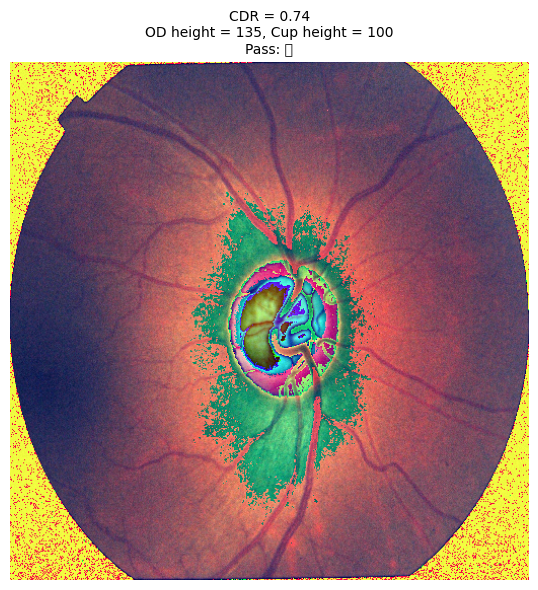

  2%|▏         | 1/50 [00:00<00:21,  2.25it/s]

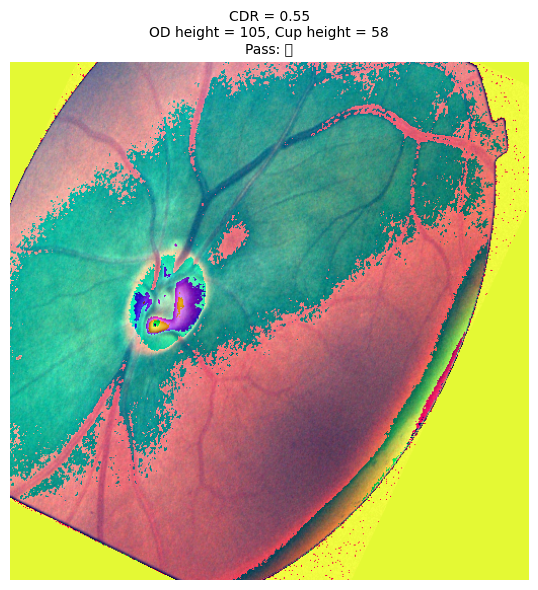

  4%|▍         | 2/50 [00:00<00:21,  2.27it/s]

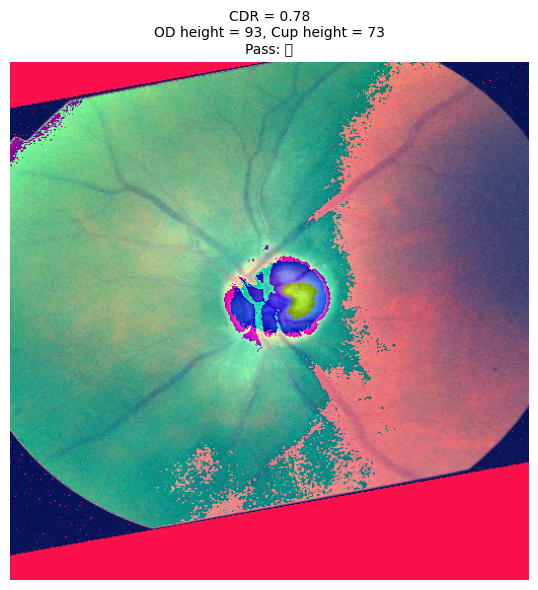

  6%|▌         | 3/50 [00:01<00:20,  2.25it/s]

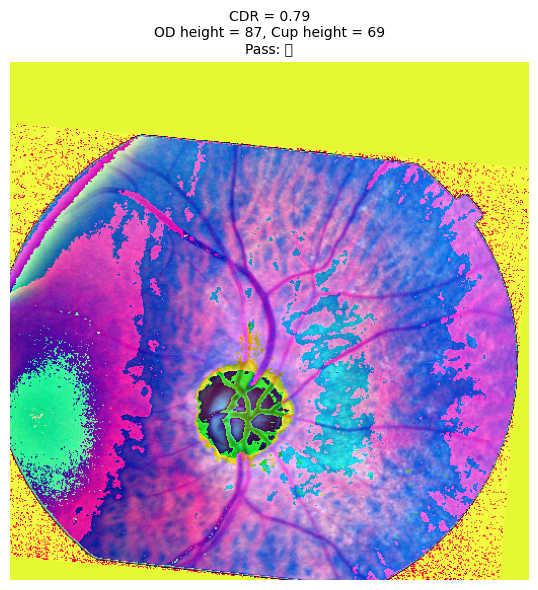

  8%|▊         | 4/50 [00:01<00:20,  2.23it/s]

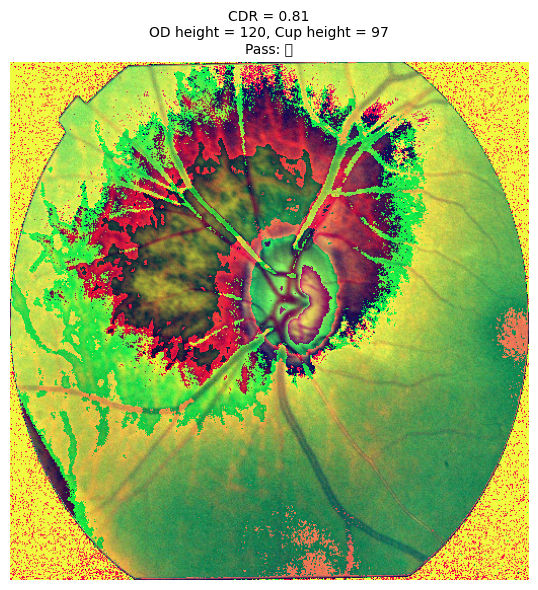

 10%|█         | 5/50 [00:02<00:20,  2.23it/s]

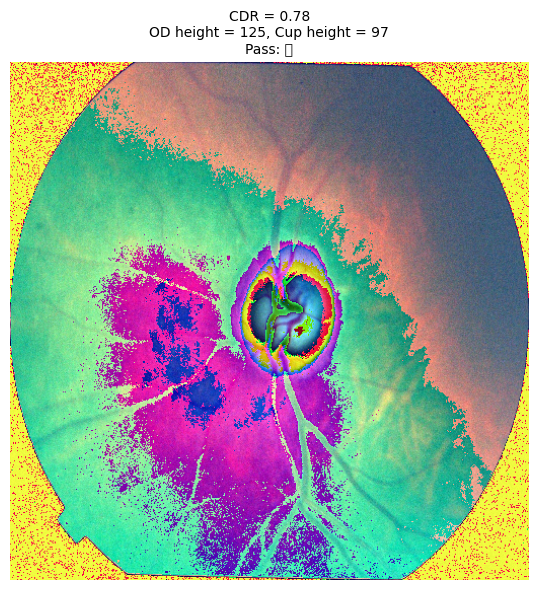

 12%|█▏        | 6/50 [00:02<00:19,  2.23it/s]

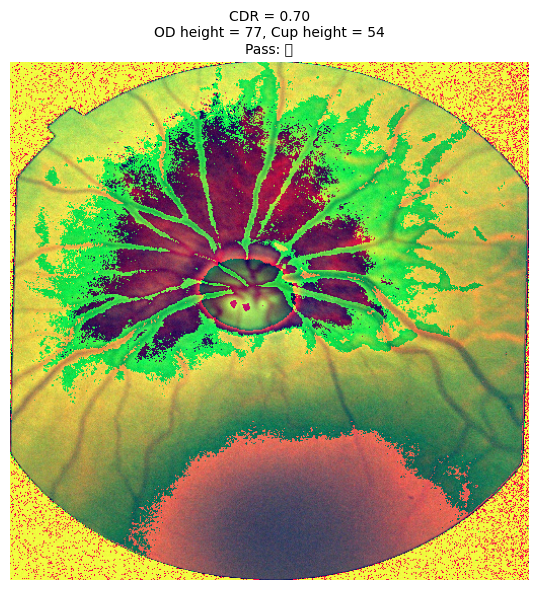

 14%|█▍        | 7/50 [00:03<00:19,  2.21it/s]

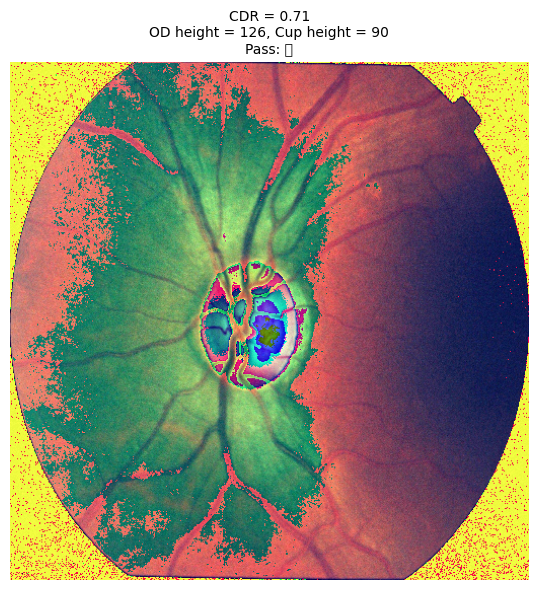

 16%|█▌        | 8/50 [00:03<00:18,  2.22it/s]

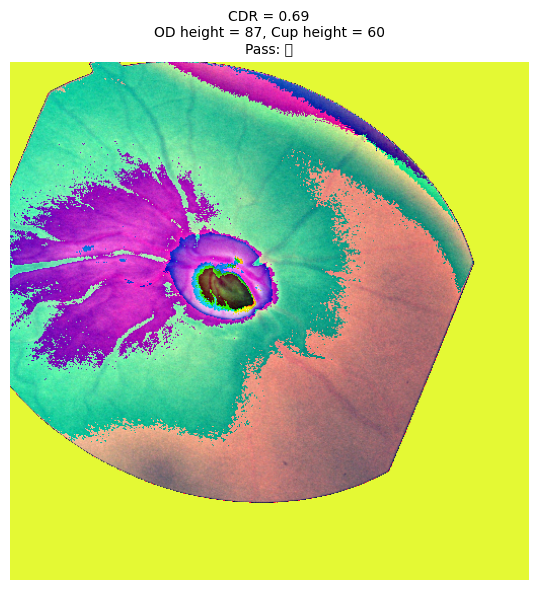

 18%|█▊        | 9/50 [00:03<00:17,  2.30it/s]<ipython-input-51-2837864475>:30: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


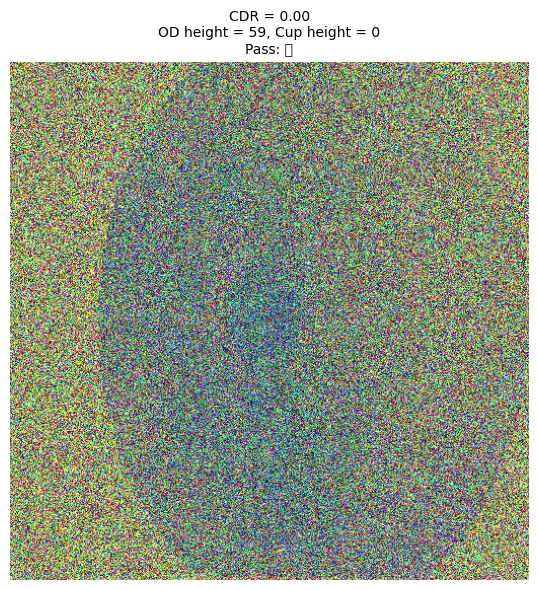

 20%|██        | 10/50 [00:04<00:17,  2.32it/s]

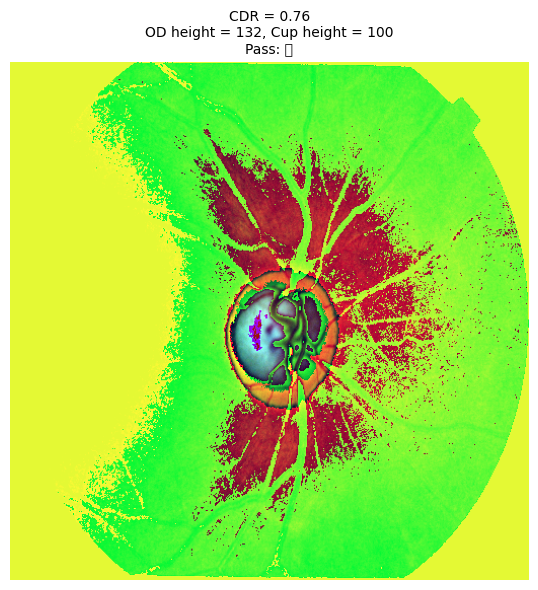

 22%|██▏       | 11/50 [00:04<00:16,  2.38it/s]

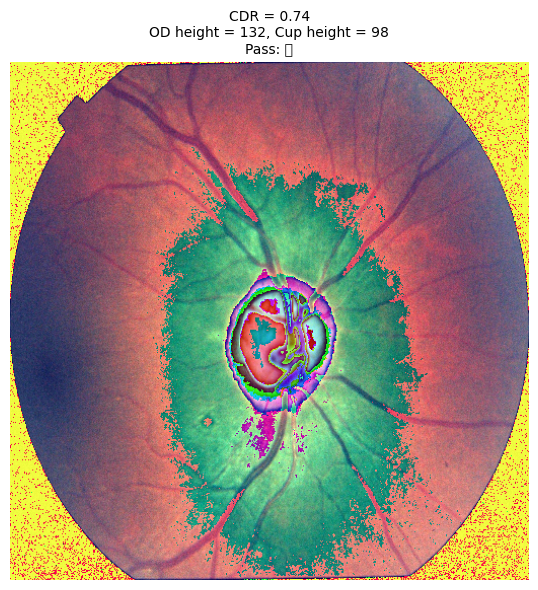

 24%|██▍       | 12/50 [00:05<00:16,  2.34it/s]

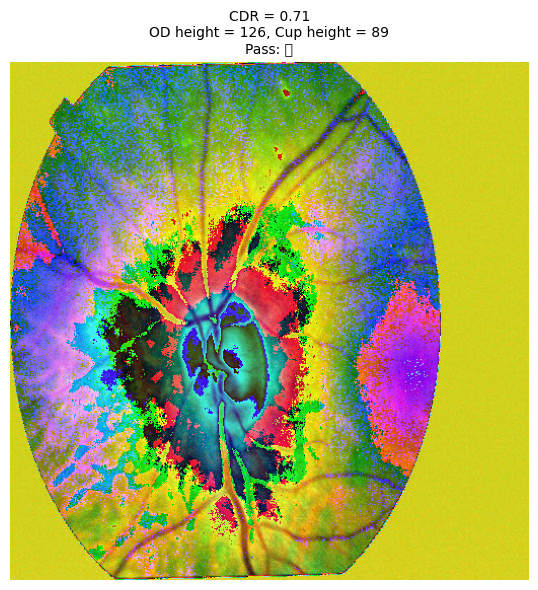

 26%|██▌       | 13/50 [00:05<00:16,  2.24it/s]

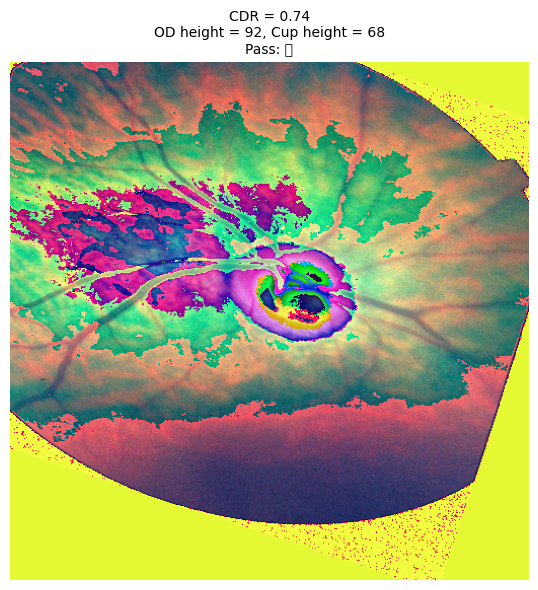

 28%|██▊       | 14/50 [00:06<00:16,  2.18it/s]

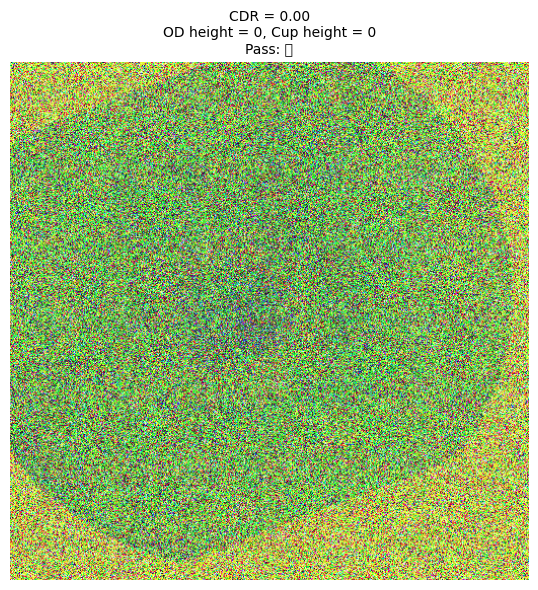

 30%|███       | 15/50 [00:06<00:15,  2.27it/s]

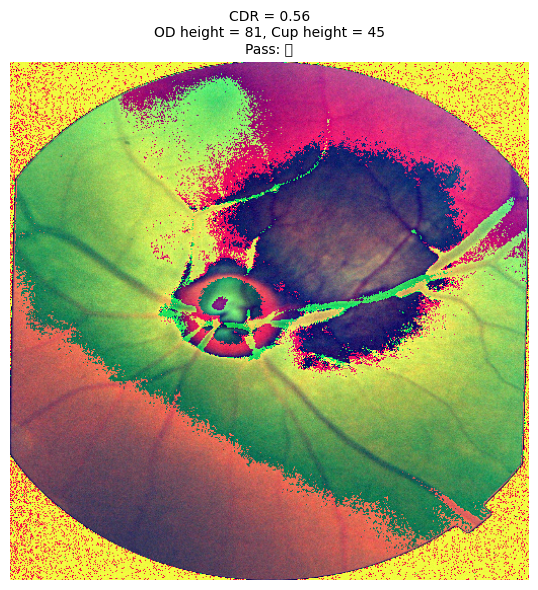

 32%|███▏      | 16/50 [00:07<00:15,  2.25it/s]

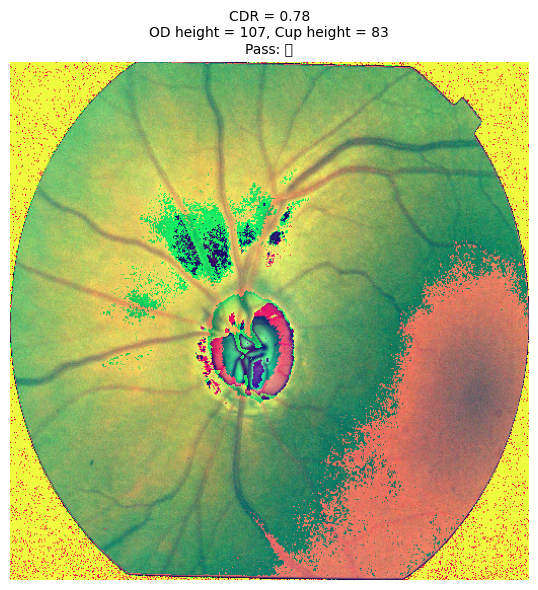

 34%|███▍      | 17/50 [00:07<00:14,  2.24it/s]

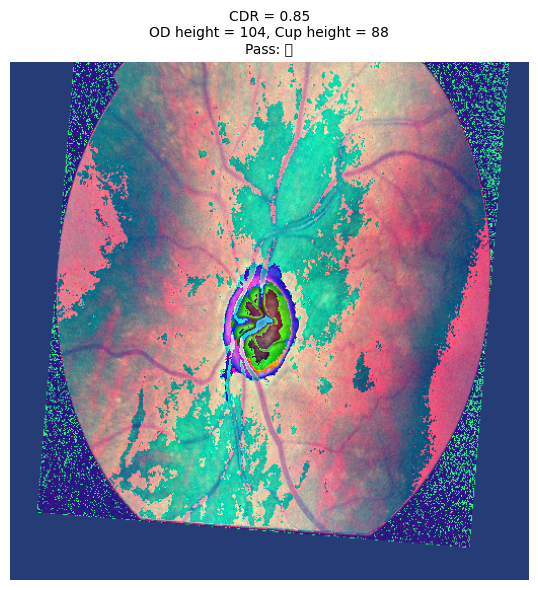

 36%|███▌      | 18/50 [00:07<00:13,  2.29it/s]

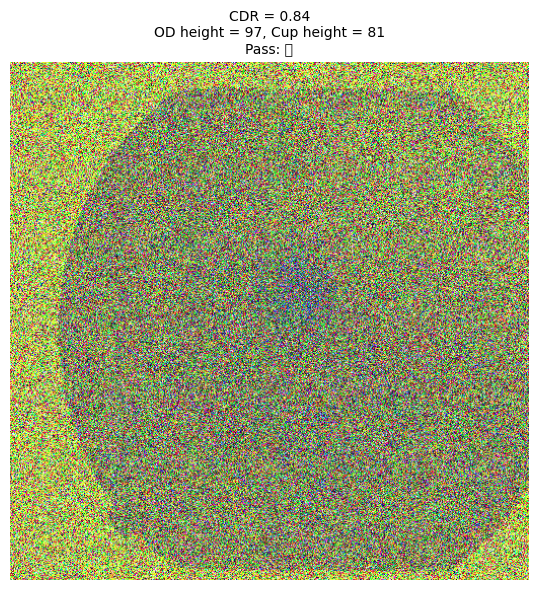

 38%|███▊      | 19/50 [00:08<00:13,  2.34it/s]

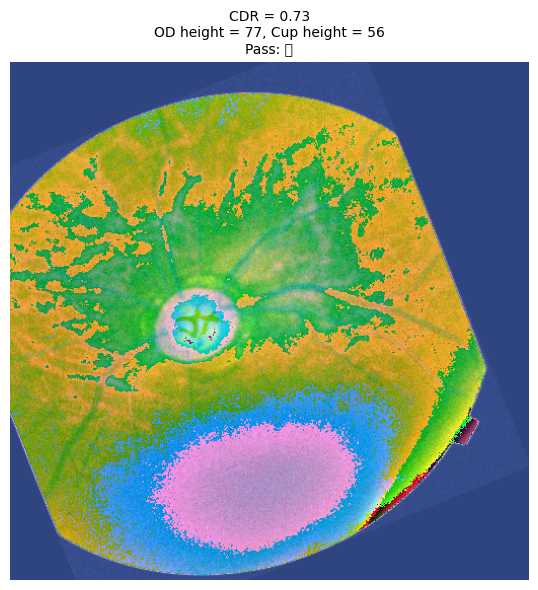

 40%|████      | 20/50 [00:08<00:12,  2.38it/s]

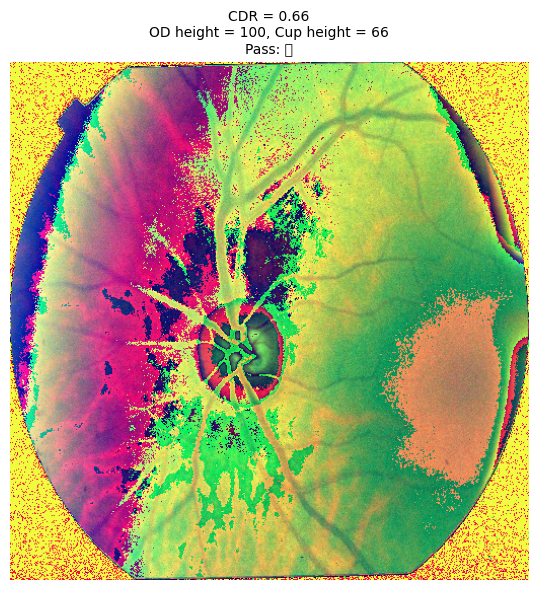

 42%|████▏     | 21/50 [00:09<00:15,  1.92it/s]

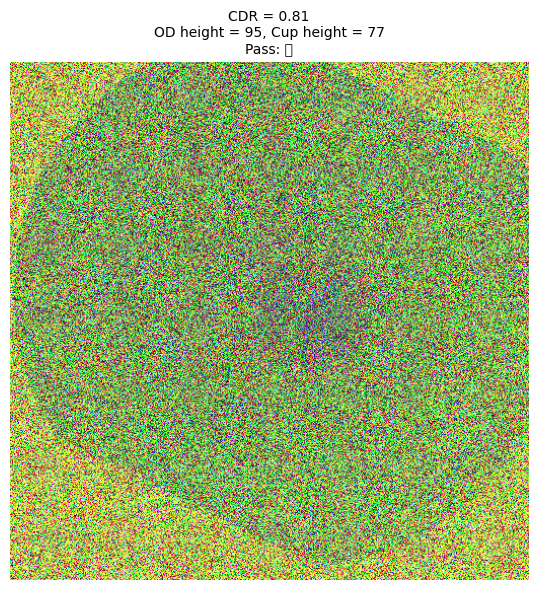

 44%|████▍     | 22/50 [00:09<00:13,  2.04it/s]

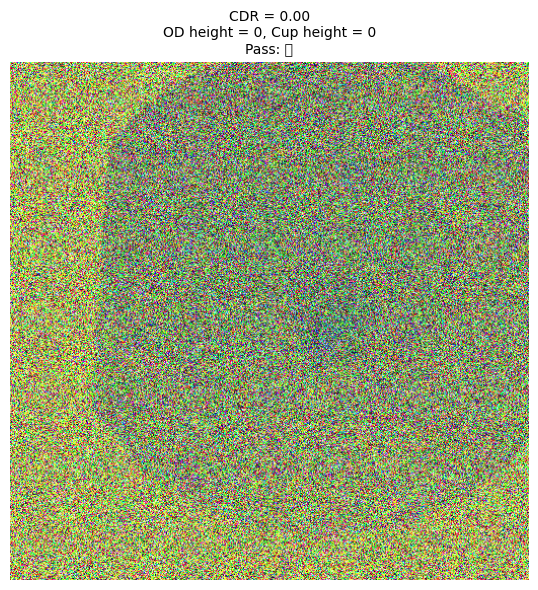

 46%|████▌     | 23/50 [00:10<00:12,  2.11it/s]

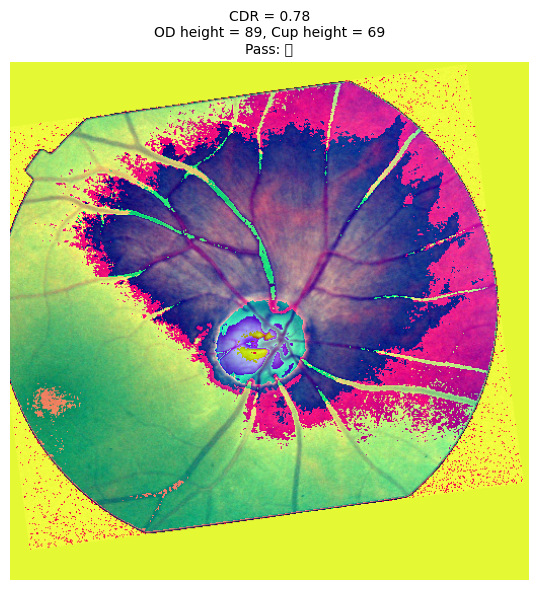

 48%|████▊     | 24/50 [00:10<00:12,  2.16it/s]

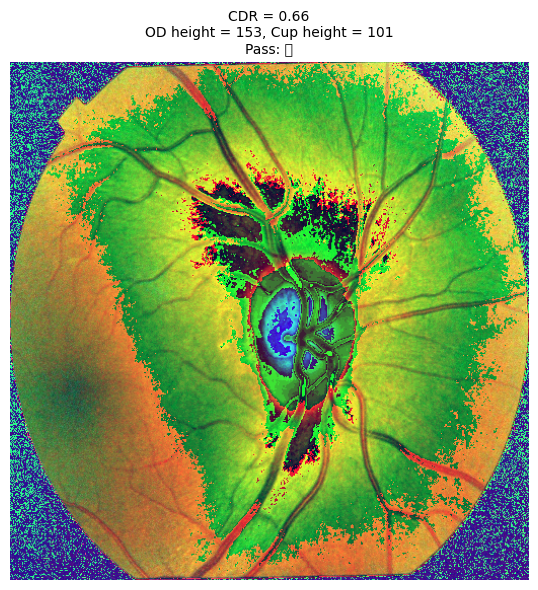

 50%|█████     | 25/50 [00:11<00:11,  2.14it/s]

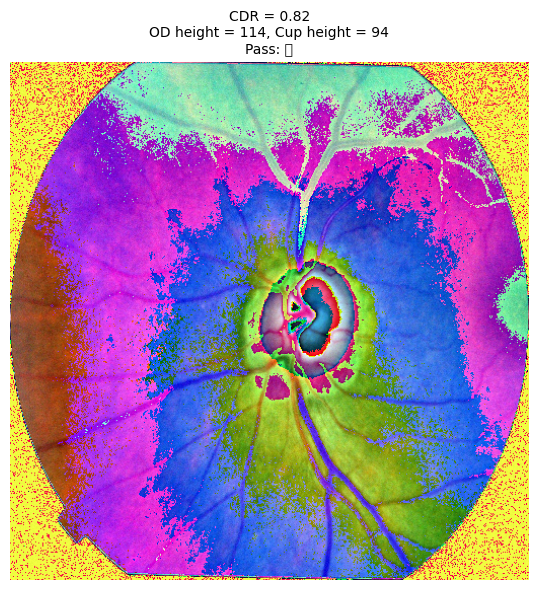

 52%|█████▏    | 26/50 [00:11<00:11,  2.15it/s]

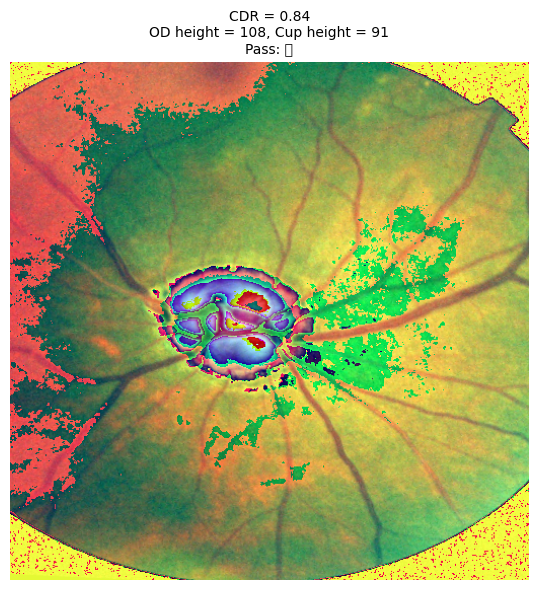

 54%|█████▍    | 27/50 [00:12<00:10,  2.10it/s]

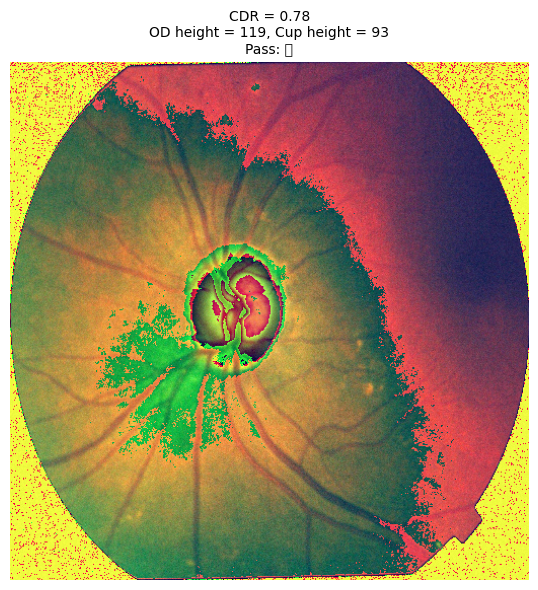

 56%|█████▌    | 28/50 [00:12<00:10,  2.13it/s]

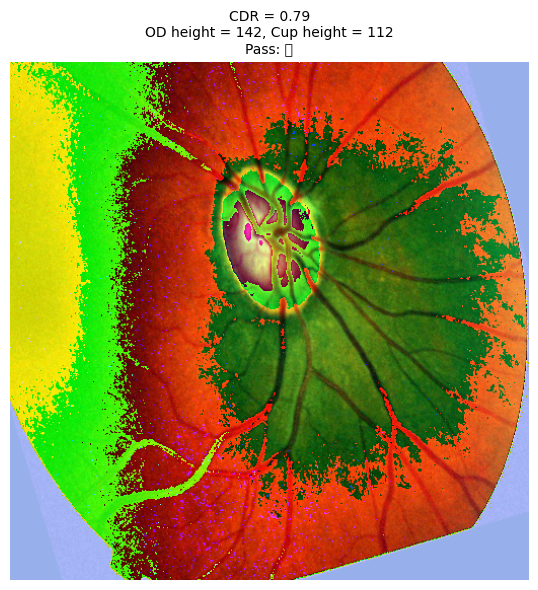

 58%|█████▊    | 29/50 [00:13<00:09,  2.12it/s]

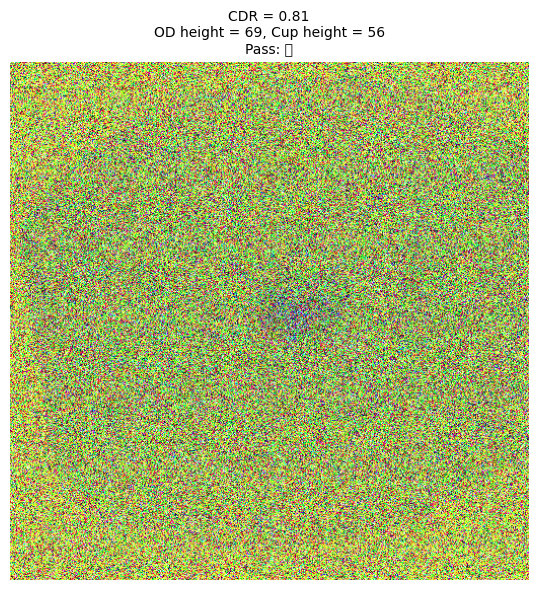

 60%|██████    | 30/50 [00:13<00:09,  2.22it/s]

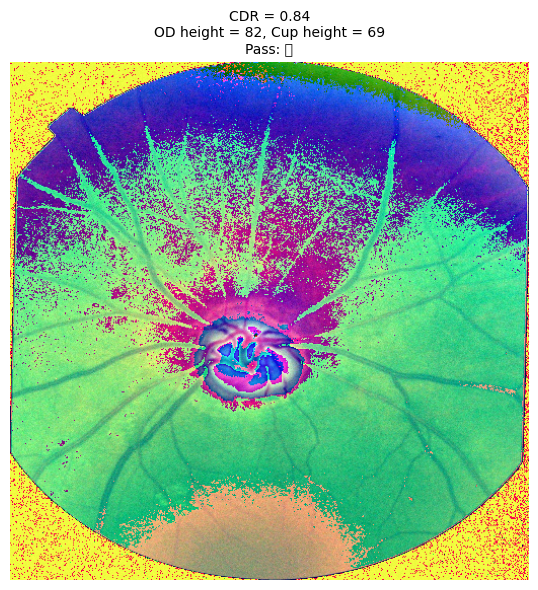

 62%|██████▏   | 31/50 [00:14<00:08,  2.22it/s]

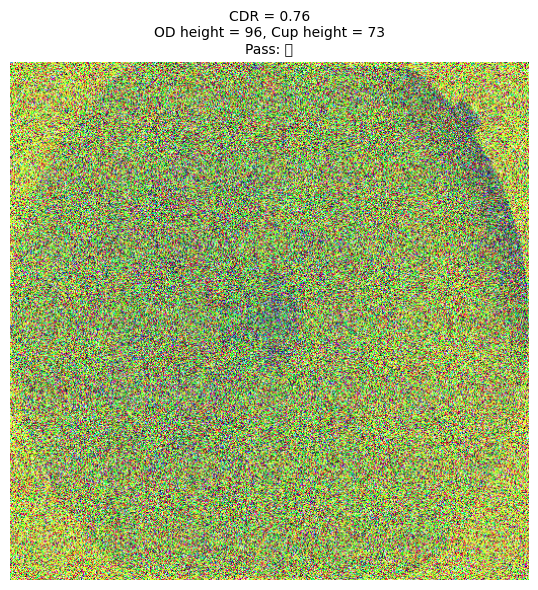

 64%|██████▍   | 32/50 [00:14<00:07,  2.31it/s]

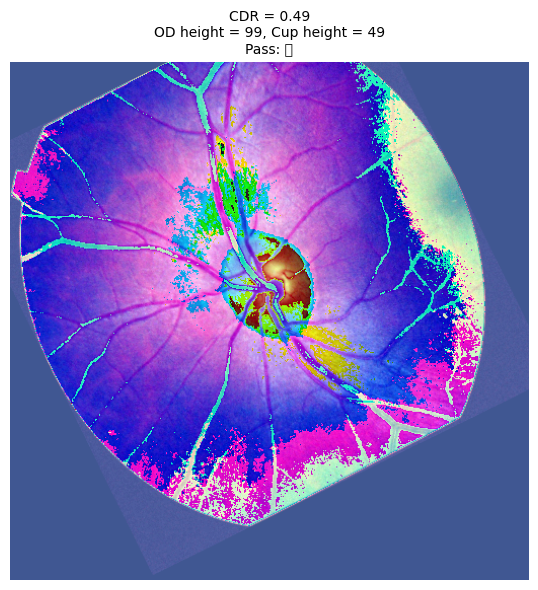

 66%|██████▌   | 33/50 [00:14<00:07,  2.33it/s]

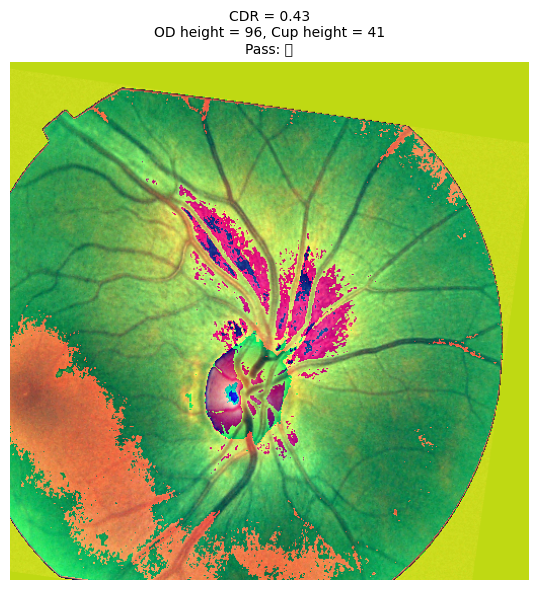

 68%|██████▊   | 34/50 [00:15<00:06,  2.29it/s]

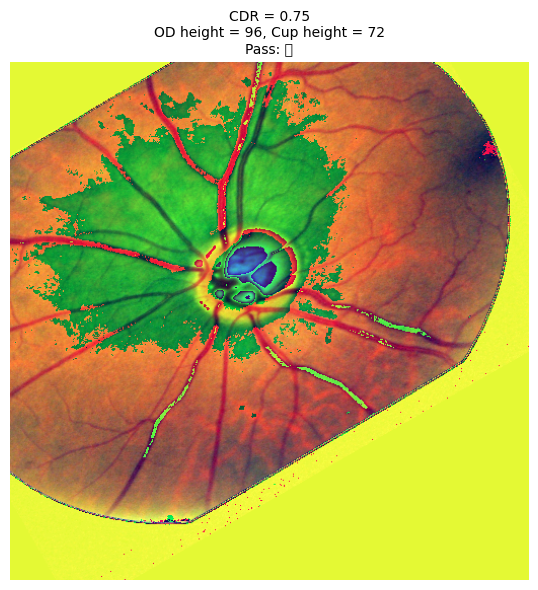

 70%|███████   | 35/50 [00:15<00:06,  2.23it/s]

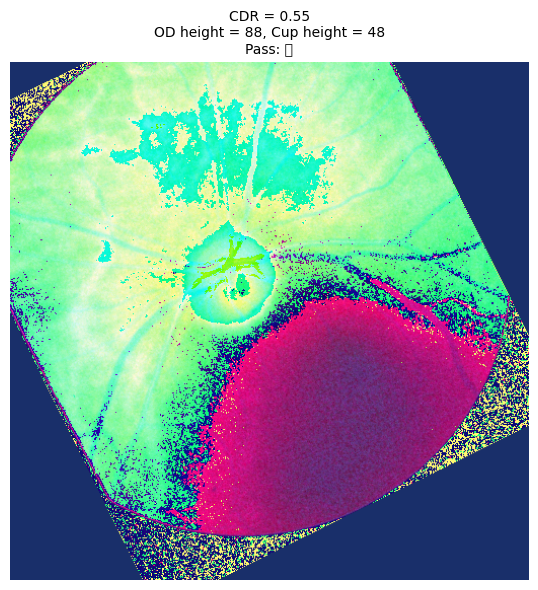

 72%|███████▏  | 36/50 [00:16<00:06,  2.24it/s]

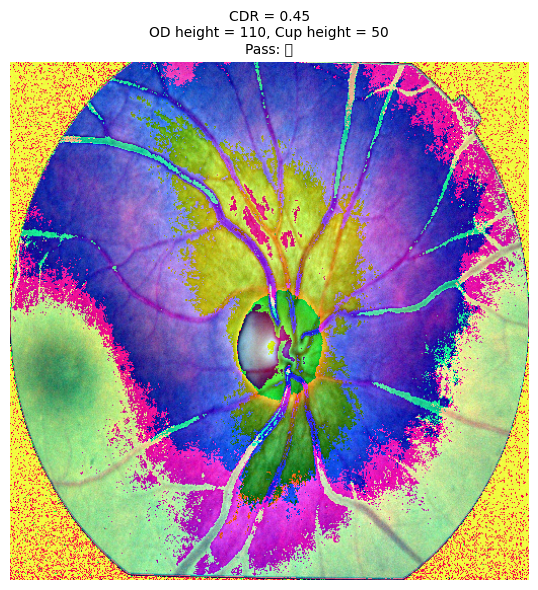

 74%|███████▍  | 37/50 [00:16<00:05,  2.25it/s]

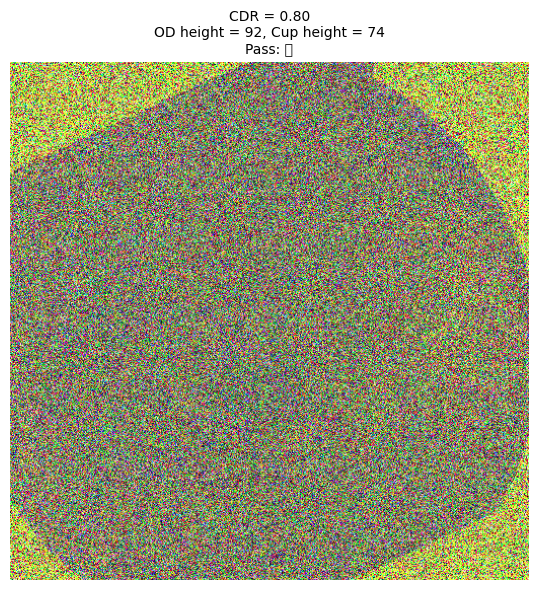

 76%|███████▌  | 38/50 [00:17<00:05,  2.32it/s]

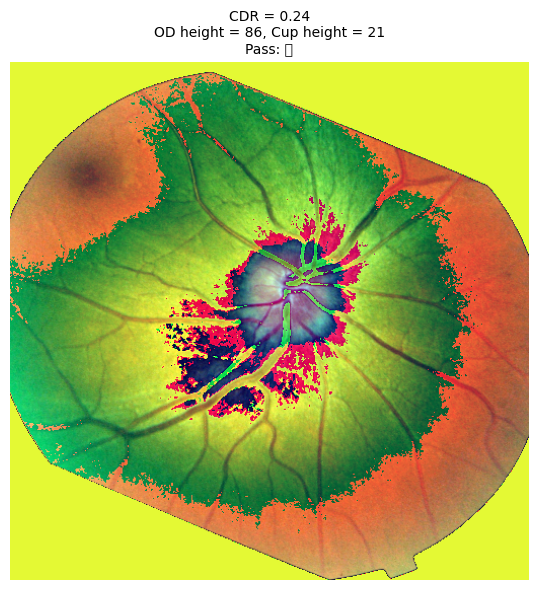

 78%|███████▊  | 39/50 [00:17<00:04,  2.32it/s]

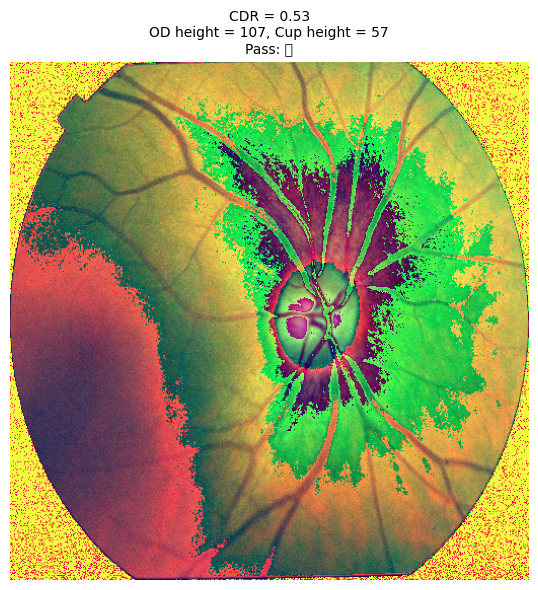

 80%|████████  | 40/50 [00:17<00:04,  2.31it/s]

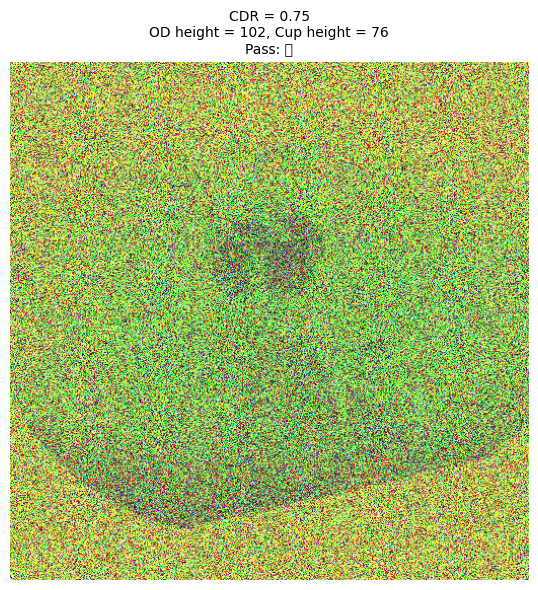

 82%|████████▏ | 41/50 [00:18<00:03,  2.36it/s]

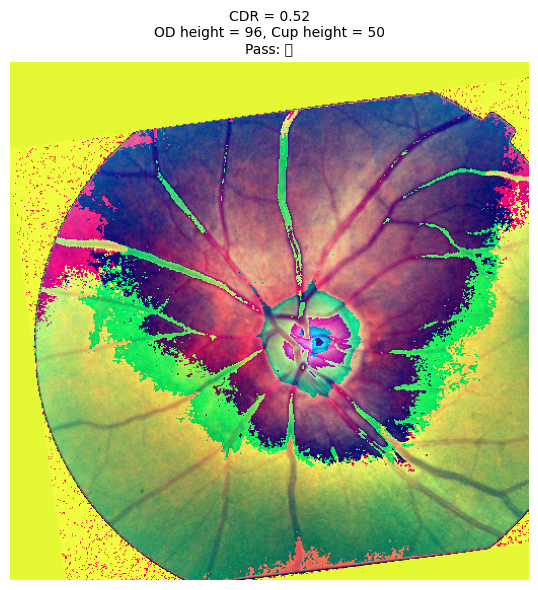

 84%|████████▍ | 42/50 [00:18<00:03,  2.32it/s]

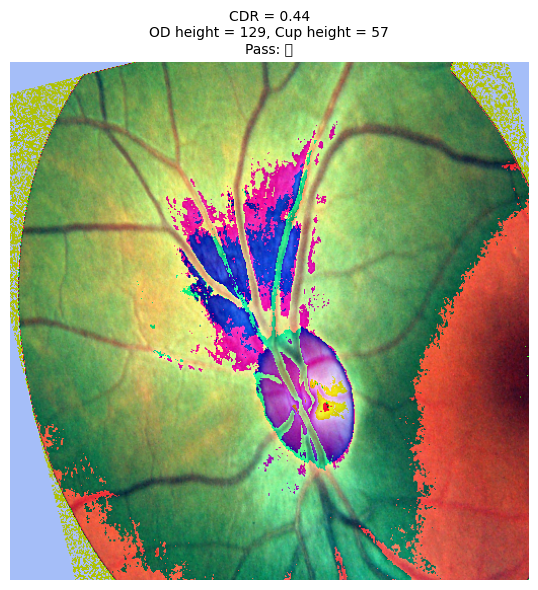

 86%|████████▌ | 43/50 [00:19<00:03,  2.26it/s]

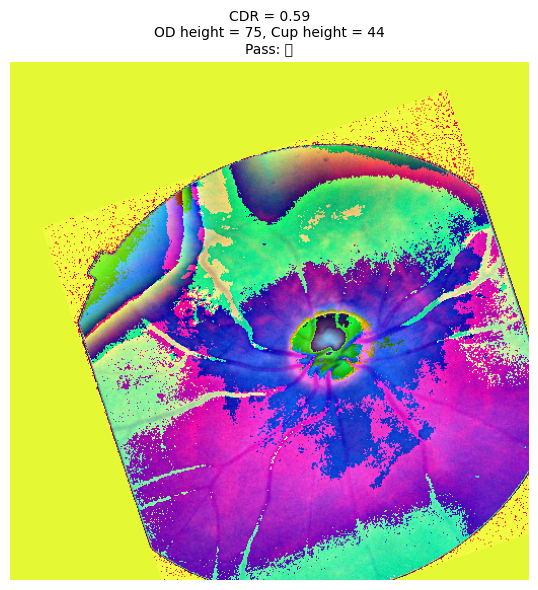

 88%|████████▊ | 44/50 [00:19<00:02,  2.32it/s]

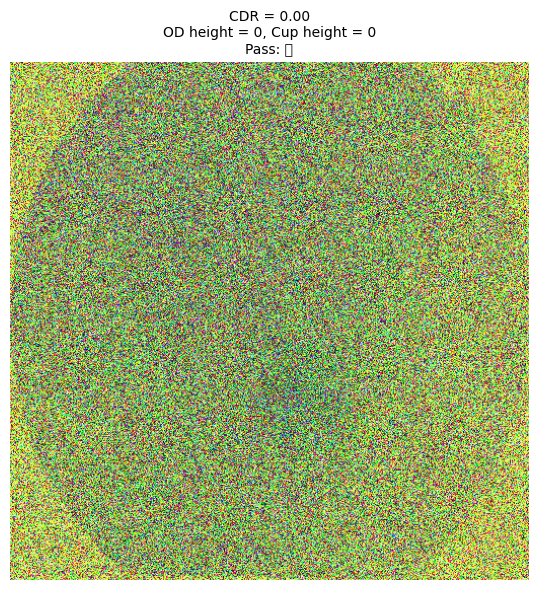

 90%|█████████ | 45/50 [00:20<00:02,  2.39it/s]

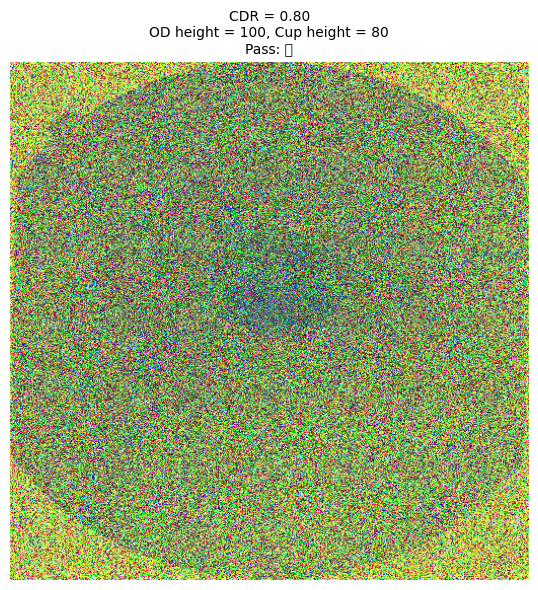

 92%|█████████▏| 46/50 [00:20<00:01,  2.42it/s]

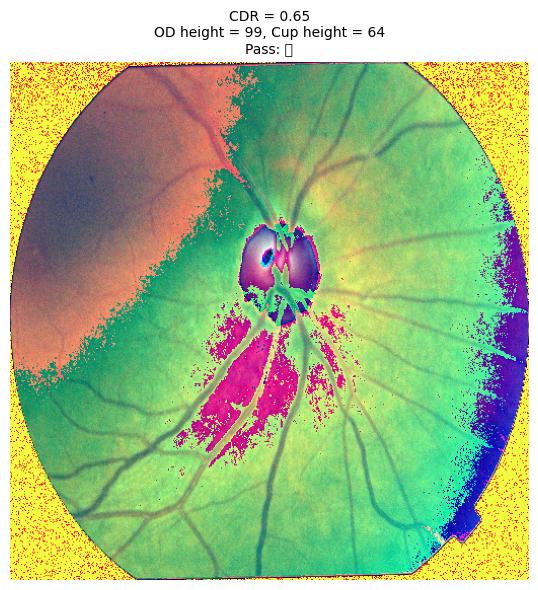

 94%|█████████▍| 47/50 [00:20<00:01,  2.35it/s]

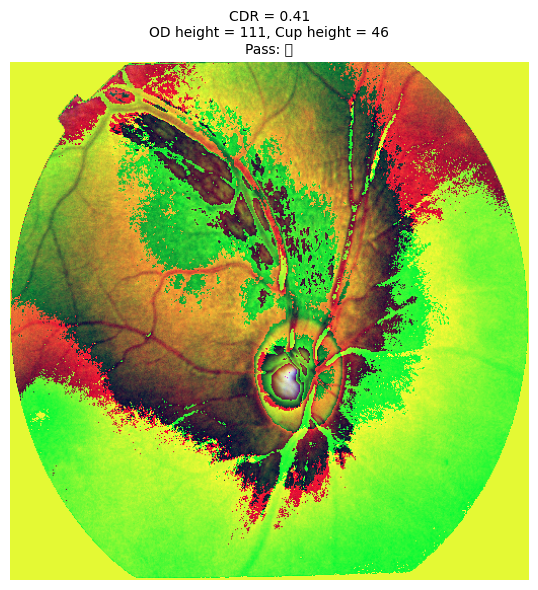

 96%|█████████▌| 48/50 [00:21<00:00,  2.35it/s]

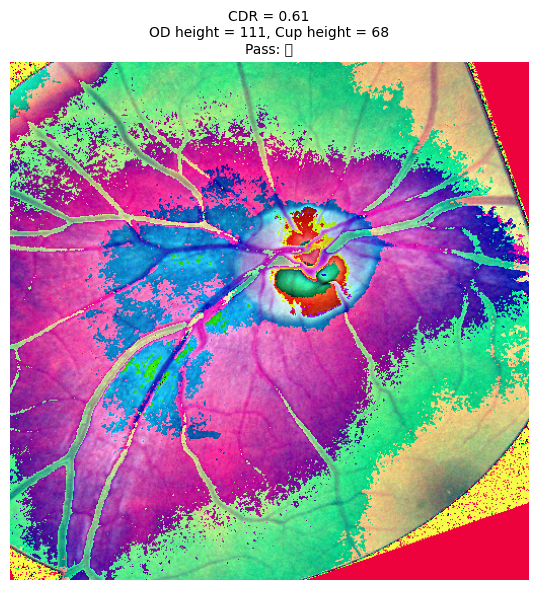

 98%|█████████▊| 49/50 [00:21<00:00,  2.25it/s]

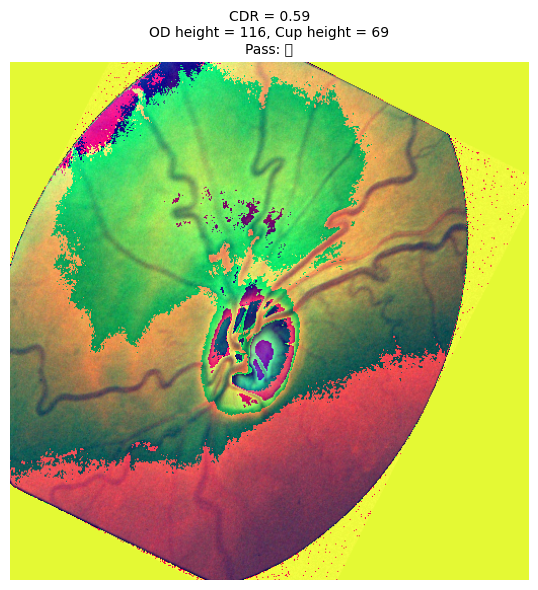

100%|██████████| 50/50 [00:22<00:00,  2.25it/s]


In [ ]:
for img_tensor, mask_tensor in tqdm(dataset):
    _ = compute_and_visualize_cdr(img_tensor, model)


### visulization of the segmentation output from the trained model

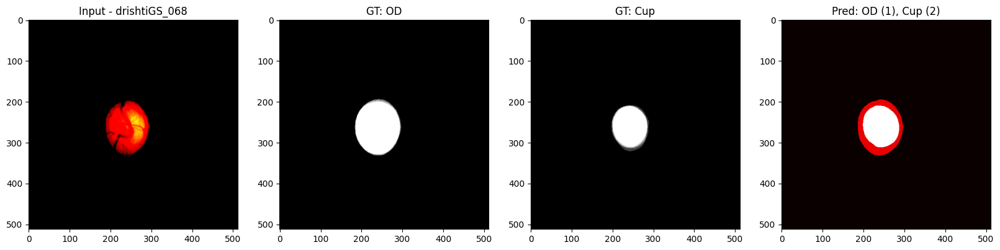

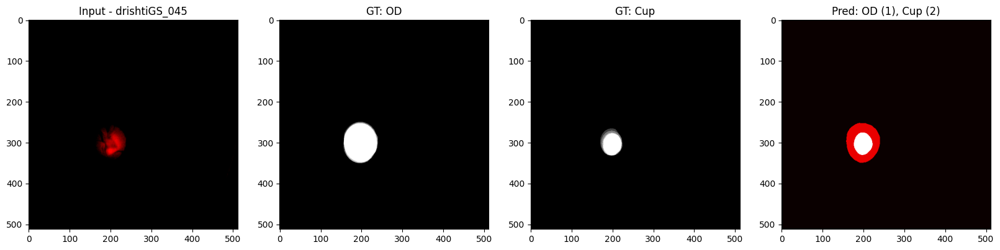

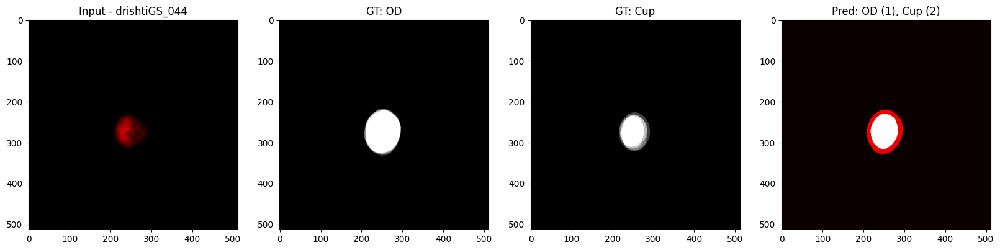

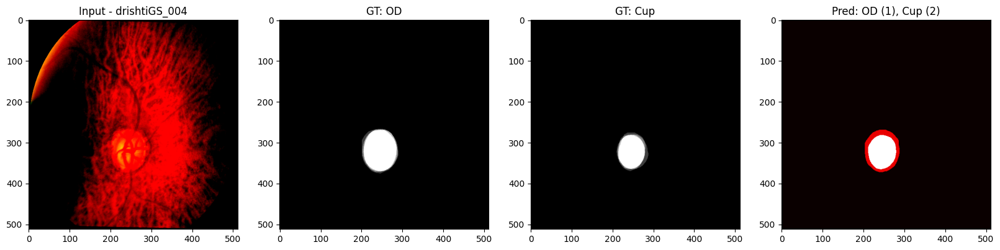

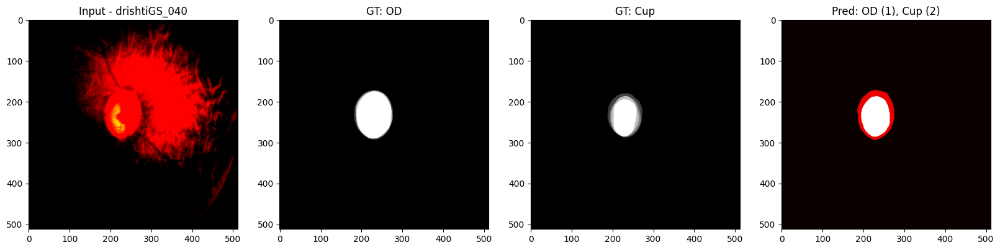

In [ ]:
# Fresh validation dataset and loader
# Define val_transform here before it's used
val_transform = A.Compose([
    A.Resize(512, 512),
    A.Normalize(),
    ToTensorV2()
])

val_dataset = DrishtiGSDataset(image_dir, gt_dir, transform=val_transform)
infer_loader = DataLoader(val_dataset, batch_size=1, shuffle=False)

model.eval()
for idx, batch in enumerate(infer_loader):
    if idx >= 5:
        break

    image, mask = batch
    image = image.to(device)

    # Get img_id from file path
    img_path = val_dataset.samples[idx]["img_path"]
    img_id = os.path.basename(img_path).replace(".png", "")

    with torch.no_grad():
        output = torch.sigmoid(model(image)).cpu().numpy()[0]

    od_pred = (output[0] > 0.5).astype(np.uint8)
    cup_pred = (output[1] > 0.5).astype(np.uint8)

    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    axs[0].imshow(image[0].cpu().permute(1, 2, 0))
    axs[0].set_title(f"Input - {img_id}")
    axs[1].imshow(mask[0][0], cmap="gray")
    axs[1].set_title("GT: OD")
    axs[2].imshow(mask[0][1], cmap="gray")
    axs[2].set_title("GT: Cup")
    axs[3].imshow(od_pred + 2 * cup_pred, cmap="hot")
    axs[3].set_title("Pred: OD (1), Cup (2)")
    plt.show()



```
# testing the trained model on the dristhi-gs
dataset it passes 49 images while 1 is filtered
out on the basis of cdr calculation
```



In [ ]:
class DrishtiGSInferenceDataset(Dataset):
    def __init__(self, image_dir, gt_dir, transform=None):
        self.image_dir = image_dir
        self.gt_dir = gt_dir
        self.transform = transform
        self.samples = []

        for cls in ["GLAUCOMA", "NORMAL"]:
            img_dir = os.path.join(image_dir, cls)
            for img_name in os.listdir(img_dir):
                if img_name.endswith(".png"):
                    base_id = img_name.replace(".png", "")
                    mask_dir = os.path.join(gt_dir, base_id, "SoftMap")
                    od_path = os.path.join(mask_dir, f"{base_id}_ODsegSoftmap.png")
                    cup_path = os.path.join(mask_dir, f"{base_id}_cupsegSoftmap.png")
                    if os.path.exists(od_path) and os.path.exists(cup_path):
                        self.samples.append({
                            "img_path": os.path.join(img_dir, img_name),
                            "od_path": od_path,
                            "cup_path": cup_path,
                            "id": base_id
                        })

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        sample = self.samples[idx]
        img = cv2.imread(sample["img_path"])[..., ::-1]
        img = cv2.resize(img, (512, 512))

        od_mask = cv2.imread(sample["od_path"], 0)
        cup_mask = cv2.imread(sample["cup_path"], 0)
        od_mask = cv2.resize(od_mask, (512, 512)) / 255.0
        cup_mask = cv2.resize(cup_mask, (512, 512)) / 255.0
        mask = np.stack([od_mask, cup_mask], axis=0)

        if self.transform:
            augmented = self.transform(image=img, mask=mask.transpose(1, 2, 0))
            img = augmented["image"]
            mask = augmented["mask"].permute(2, 0, 1)
        else:
            img = img.transpose(2, 0, 1) / 255.0
            img = torch.tensor(img, dtype=torch.float32)
            mask = torch.tensor(mask, dtype=torch.float32)

        return img, mask, sample["id"]


In [ ]:
val_transform = A.Compose([
    A.Resize(512, 512),
    A.Normalize(),
    ToTensorV2()
])

inference_dataset = DrishtiGSInferenceDataset(image_dir, gt_dir, transform=val_transform)
infer_loader = DataLoader(inference_dataset, batch_size=1, shuffle=False)

model.eval()
valid_ids = []
cdr_values = []

def vertical_extent(mask):
    coords = np.where(mask > 0)
    return coords[0].max() - coords[0].min() if coords[0].size > 0 else 0

for image, mask, img_id in tqdm(infer_loader):
    image = image.to(device)
    with torch.no_grad():
        output = torch.sigmoid(model(image)).cpu().numpy()[0]

    od_pred = (output[0] > 0.5).astype(np.uint8)
    cup_pred = (output[1] > 0.5).astype(np.uint8)

    od_h = vertical_extent(od_pred)
    cup_h = vertical_extent(cup_pred)
    cdr = cup_h / od_h if od_h > 0 else 0

    if od_h > 40 and cup_h > 20:
        valid_ids.append(img_id)
        cdr_values.append((img_id, cdr))

with open("cdr_filtered_ids.txt", "w") as f:
    for img_id, cdr in cdr_values:
        f.write(f"{img_id},{cdr:.4f}\n")

print(f"✅ CDR filtering complete. Valid IDs: {len(valid_ids)}")


100%|██████████| 50/50 [00:09<00:00,  5.47it/s]

✅ CDR filtering complete. Valid IDs: 49


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import cv2
import torch

model.eval()

threshold_od = 25
threshold_cup = 10

failed_samples = []
passed_samples = []

def vertical_extent(mask):
    coords = np.where(mask > 0)
    return coords[0].max() - coords[0].min() if coords[0].size > 0 else 0

for idx in tqdm(range(len(dataset))):
    img_tensor, _ = dataset[idx]
    img_tensor = img_tensor.to(device)
    with torch.no_grad():
        output = torch.sigmoid(model(img_tensor.unsqueeze(0))).squeeze(0).cpu().numpy()

    od_pred = (output[0] > 0.5).astype(np.uint8)
    cup_pred = (output[1] > 0.5).astype(np.uint8)

    od_h = vertical_extent(od_pred)
    cup_h = vertical_extent(cup_pred)
    cdr = cup_h / od_h if od_h > 0 else 0

    status = (od_h > threshold_od) and (cup_h > threshold_cup)

    record = {
        "idx": idx,
        "od_h": od_h,
        "cup_h": cup_h,
        "cdr": cdr,
        "status": status,
        "img_tensor": img_tensor.cpu()
    }

    if status:
        passed_samples.append(record)
    else:
        failed_samples.append(record)

print(f"Failed count: {len(failed_samples)}, Passed count: {len(passed_samples)}")

# Visualize distributions
od_heights = [s['od_h'] for s in passed_samples + failed_samples]
cup_heights = [s['cup_h'] for s in passed_samples + failed_samples]
cdrs = [s['cdr'] for s in passed_samples + failed_samples]
statuses = [s['status'] for s in passed_samples + failed_samples]

plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
plt.title("OD Heights distribution")
plt.hist([s['od_h'] for s in passed_samples], bins=30, alpha=0.7, label="Passed")
plt.hist([s['od_h'] for s in failed_samples], bins=30, alpha=0.7, label="Failed")
plt.axvline(threshold_od, color='r', linestyle='--', label='Threshold OD')
plt.legend()

plt.subplot(1, 3, 2)
plt.title("Cup Heights distribution")
plt.hist([s['cup_h'] for s in passed_samples], bins=30, alpha=0.7, label="Passed")
plt.hist([s['cup_h'] for s in failed_samples], bins=30, alpha=0.7, label="Failed")
plt.axvline(threshold_cup, color='r', linestyle='--', label='Threshold Cup')
plt.legend()

plt.subplot(1, 3, 3)
plt.title("CDR distribution")
plt.hist([s['cdr'] for s in passed_samples], bins=30, alpha=0.7, label="Passed")
plt.hist([s['cdr'] for s in failed_samples], bins=30, alpha=0.7, label="Failed")
plt.legend()

plt.tight_layout()
plt.show()

# Visualize some failed images with overlays
num_vis = min(5, len(failed_samples))
for i in range(num_vis):
    s = failed_samples[i]
    img_np = s['img_tensor'].permute(1, 2, 0).numpy()
    img_np = (img_np * 255).astype(np.uint8)

    od_pred = (torch.sigmoid(model(s['img_tensor'].unsqueeze(0).to(device)))[0][0] > 0.5).cpu().numpy().astype(np.uint8)
    cup_pred = (torch.sigmoid(model(s['img_tensor'].unsqueeze(0).to(device)))[0][1] > 0.5).cpu().numpy().astype(np.uint8)

    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    axs[0].imshow(img_np)
    axs[0].set_title(f"Original Image idx {s['idx']}")
    axs[1].imshow(od_pred, cmap='gray')
    axs[1].set_title("Optic Disc Mask")
    axs[2].imshow(cup_pred, cmap='gray')
    axs[2].set_title("Optic Cup Mask")
    axs[3].imshow(img_np)
    axs[3].imshow(od_pred, alpha=0.5, cmap='Reds')
    axs[3].imshow(cup_pred, alpha=0.5, cmap='Blues')
    axs[3].set_title(f"Overlay\nOD height={s['od_h']}, Cup height={s['cup_h']}")
    for ax in axs:
        ax.axis('off')
    plt.show()


In [ ]:
import numpy as np

# Extract arrays for passed samples
od_heights_passed = np.array([s['od_h'] for s in passed_samples])
cup_heights_passed = np.array([s['cup_h'] for s in passed_samples])

# Calculate 5th percentile thresholds to filter out edge cases
new_threshold_od = np.percentile(od_heights_passed, 5)
new_threshold_cup = np.percentile(cup_heights_passed, 5)

print(f"Old thresholds: OD={threshold_od}, Cup={threshold_cup}")
print(f"New thresholds (5th percentile of passed): OD={new_threshold_od:.2f}, Cup={new_threshold_cup:.2f}")


In [ ]:
def variance_of_laplacian(img_np_gray):
    return cv2.Laplacian(img_np_gray, cv2.CV_64F).var()

blur_threshold = 100.0  # Tune this threshold based on experimentation

filtered_passed_samples = []

for s in tqdm(passed_samples):
    img_tensor = s['img_tensor']
    img_np = img_tensor.permute(1, 2, 0).numpy()
    img_np = (img_np * 255).astype(np.uint8)
    img_gray = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)

    blur_var = variance_of_laplacian(img_gray)

    if blur_var >= blur_threshold:
        filtered_passed_samples.append(s)

print(f"Passed samples before blur filter: {len(passed_samples)}")
print(f"Passed samples after blur filter: {len(filtered_passed_samples)}")
print(f"Blur filter rejection rate: {(len(passed_samples) - len(filtered_passed_samples))/len(passed_samples)*100:.2f}%")


# till now we have just create the filters as well as just started to check out few outputs or results on demo images 🇱
### now we have to preprocess the datasets and filters one by one .
 after which we will conclude towards fine tuning the dino V2 model and see for our results



# DRISTHI-GS

In [ ]:
!pip install -q kagglehub
import kagglehub

# Download Drishti-GS via KaggleHub
kagglehub.dataset_download("lokeshsaipureddi/drishtigs-retina-dataset-for-onh-segmentation")

In [ ]:
import os
import shutil
from tqdm import tqdm
import kagglehub

# Download Drishti-GS via KaggleHub
path = kagglehub.dataset_download("lokeshsaipureddi/drishtigs-retina-dataset-for-onh-segmentation")

# Print the contents of the downloaded directory
print(f"Contents of downloaded directory: {os.listdir(path)}")

# Target structure
target_dir = "/content/drive/MyDrive/glaucoma_detection/unified_DRISHTI-GS"
gon_pos_dir = os.path.join(target_dir, "GON+")
gon_neg_dir = os.path.join(target_dir, "GON-")
os.makedirs(gon_pos_dir, exist_ok=True)
os.makedirs(gon_neg_dir, exist_ok=True)

# Extract image ID
def extract_id(fname):
    try:
        return int(fname.split("_")[-1].split(".")[0])
    except:
        return None

# Based on the output of os.listdir(path), adjust the source_dir path
# The images are in the 'Training' folder within 'Training-20211018T055246Z-001'
source_dir_training = os.path.join(path, "Training-20211018T055246Z-001", "Training", "Images")

# You might also want to process images from the 'Test' directory if needed
# source_dir_test = os.path.join(path, "Test-20211018T060000Z-001", "Test", "Images")

# Process images from the training directory
if not os.path.exists(source_dir_training):
    print(f"Error: Source directory not found: {source_dir_training}")
else:
    image_files = [f for f in os.listdir(source_dir_training) if f.endswith(".png")] # Changed to .png
    for fname in tqdm(image_files, desc="Classifying Drishti-GS training images"):
        img_id = extract_id(fname)
        if img_id is None:
            continue

        src = os.path.join(source_dir_training, fname)
        # Assuming images 1-24 are GON+ and 25-50 are GON- based on the dataset
        dst = os.path.join(gon_pos_dir if 1 <= img_id <= 24 else gon_neg_dir, fname)
        shutil.copy(src, dst)

    print("\n✅ Drishti-GS training images standardized using KaggleHub source.")

# You can add similar logic here to process the test images if needed
# if not os.path.exists(source_dir_test):
#     print(f"Error: Source directory not found: {source_dir_test}")
# else:
#     image_files_test = [f for f in os.listdir(source_dir_test) if f.endswith(".png")]
#     for fname in tqdm(image_files_test, desc="Classifying Drishti-GS test images"):
#         img_id = extract_id(fname)
#         if img_id is None:
#             continue
#         src = os.path.join(source_dir_test, fname)
#         # You'll need to determine the classification for test images if not explicitly provided
#         # For now, let's assume they are all GON- for demonstration
#         dst = os.path.join(gon_neg_dir, fname)
#         shutil.copy(src, dst)
#     print("\n✅ Drishti-GS test images standardized using KaggleHub source.")

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from tqdm import tqdm
from torchvision import transforms
import albumentations as A
from albumentations.pytorch import ToTensorV2
import matplotlib.pyplot as plt
import segmentation_models_pytorch as smp
import kagglehub
import shutil

# ========== CONFIG ==========
path = kagglehub.dataset_download("lokeshsaipureddi/drishtigs-retina-dataset-for-onh-segmentation")
DRISHTI_IMAGE_DIR = os.path.join(path, "Training-20211018T055246Z-001", "Training", "Images")
OUT_DIR = "/content/drive/MyDrive/glaucoma_detection/unified_DRISHTI-GS"
META_JSON = os.path.join(OUT_DIR, "metadata.json")
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
os.makedirs(OUT_DIR, exist_ok=True)

# === GON+/GON- folders ===
GON_POS_DIR = os.path.join(OUT_DIR, "GON+")
GON_NEG_DIR = os.path.join(OUT_DIR, "GON-")
os.makedirs(GON_POS_DIR, exist_ok=True)
os.makedirs(GON_NEG_DIR, exist_ok=True)

# ========== TRANSFORMS ==========
val_transform = A.Compose([
    A.Resize(512, 512),
    A.Normalize(),
    ToTensorV2()
])

print("DRISHTI_IMAGE_DIR:", DRISHTI_IMAGE_DIR)
print("Exists:", os.path.exists(DRISHTI_IMAGE_DIR))
print("Files:", os.listdir(DRISHTI_IMAGE_DIR))

# ========== LOAD MODEL ==========
model_path = "/content/drive/MyDrive/glaucoma_detection/unet_resnet34_drishti.pth"
model = smp.Unet(encoder_name="resnet34", encoder_weights="imagenet", in_channels=3, classes=2)
model.load_state_dict(torch.load(model_path, map_location=DEVICE))
model = model.to(DEVICE)
model.eval()

# ========== COPY IMAGES TO GON+/GON- ==========
GLAUCOMA_DIR = os.path.join(DRISHTI_IMAGE_DIR, "GLAUCOMA")
NORMAL_DIR = os.path.join(DRISHTI_IMAGE_DIR, "NORMAL")

# Copy GLAUCOMA images → GON+
for fname in tqdm(os.listdir(GLAUCOMA_DIR), desc="Copying GLAUCOMA → GON+"):
    src = os.path.join(GLAUCOMA_DIR, fname)
    dst = os.path.join(GON_POS_DIR, fname)
    if fname.lower().endswith((".png", ".jpg", ".jpeg")):
        shutil.copy2(src, dst)

# Copy NORMAL images → GON-
for fname in tqdm(os.listdir(NORMAL_DIR), desc="Copying NORMAL → GON-"):
    src = os.path.join(NORMAL_DIR, fname)
    dst = os.path.join(GON_NEG_DIR, fname)
    if fname.lower().endswith((".png", ".jpg", ".jpeg")):
        shutil.copy2(src, dst)

# ========== HELPER FUNCTIONS ==========
def vertical_extent(mask):
    coords = np.where(mask > 0)
    return coords[0].max() - coords[0].min() if coords[0].size > 0 else 0

def preprocess_and_save(img_path, out_path, model, device, transform, threshold_od=25, threshold_cup=10):
    img = cv2.imread(img_path)[..., ::-1]
    transformed = transform(image=img)
    tensor = transformed["image"].unsqueeze(0).to(device)

    with torch.no_grad():
        output = torch.sigmoid(model(tensor)).cpu().numpy()[0]

    od_pred = (output[0] > 0.5).astype(np.uint8)
    cup_pred = (output[1] > 0.5).astype(np.uint8)

    od_h = vertical_extent(od_pred)
    cup_h = vertical_extent(cup_pred)
    cdr = cup_h / od_h if od_h > 0 else 0
    passed = (od_h > threshold_od) and (cup_h > threshold_cup)

    # Save masks only if passed
    if passed:
        np.savez_compressed(
            os.path.join(out_path, os.path.splitext(os.path.basename(img_path))[0] + "_mask.npz"),
            od=od_pred,
            cup=cup_pred
        )

    return passed, cdr, od_h, cup_h

# ========== MAIN LOOP ==========
print("[INFO] Starting DRISHTI-GS filtering and metadata generation...\n")

# Recursively collect all images
image_paths = sorted([
    os.path.join(root, fname)
    for root, _, files in os.walk(DRISHTI_IMAGE_DIR)
    for fname in files
    if fname.lower().endswith((".png", ".jpg", ".jpeg"))
])

metadata = []
for img_path in tqdm(image_paths, desc="Filtering images"):
    image_id = os.path.splitext(os.path.basename(img_path))[0]
    passed, cdr, od_h, cup_h = preprocess_and_save(img_path, OUT_DIR, model, DEVICE, val_transform)
    metadata.append({
        "image_id": image_id,
        "cdr": float(cdr),
        "od_h": int(od_h),
        "cup_h": int(cup_h),
        "filter_pass": bool(passed)
    })

# Save metadata
with open(META_JSON, "w") as f:
    json.dump(metadata, f, indent=2)

passed_count = sum(m["filter_pass"] for m in metadata)
print(f"\n[INFO] Saved metadata with {passed_count} passed out of {len(metadata)} "
      f"({100 * passed_count / len(metadata):.2f}%)")


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import json
import os

# Paths
image_dir = DRISHTI_IMAGE_DIR  # directory with GLAUCOMA and NORMAL subfolders
mask_dir = OUT_DIR             # where the _mask.npz files are saved
meta_path = META_JSON

# Load metadata
with open(meta_path, "r") as f:
    metadata = json.load(f)

# Filter passed entries
passed_entries = [m for m in metadata if m["filter_pass"]]

# Show N examples
num_samples = 5
for i in range(num_samples):
    entry = passed_entries[i]
    image_id = entry["image_id"]
    cdr = entry["cdr"]

    # Load image
    subdir = "GLAUCOMA" if "1" <= image_id.split("_")[-1] <= "24" else "NORMAL"  # heuristic fallback
    possible_paths = [
        os.path.join(image_dir, "GLAUCOMA", f"{image_id}.png"),
        os.path.join(image_dir, "NORMAL", f"{image_id}.png"),
        os.path.join(image_dir, "GLAUCOMA", f"{image_id}.jpg"),
        os.path.join(image_dir, "NORMAL", f"{image_id}.jpg")
    ]
    image_path = next((p for p in possible_paths if os.path.exists(p)), None)
    if not image_path:
        print(f"❌ Image not found for ID: {image_id}")
        continue
    image = cv2.imread(image_path)[..., ::-1]

    # Load masks
    mask_path = os.path.join(mask_dir, f"{image_id}_mask.npz")
    if not os.path.exists(mask_path):
        print(f"❌ Mask not found for ID: {image_id}")
        continue
    mask_npz = np.load(mask_path)
    od_mask = mask_npz["od"]
    cup_mask = mask_npz["cup"]

    # Resize masks to original image size if needed
    od_mask = cv2.resize(od_mask, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_NEAREST)
    cup_mask = cv2.resize(cup_mask, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_NEAREST)

    # Overlay masks
    overlay = image.copy()
    overlay[od_mask == 1] = [255, 0, 0]   # OD = Red
    overlay[cup_mask == 1] = [0, 255, 0]  # Cup = Green

    # Display
    plt.figure(figsize=(10, 5))
    plt.imshow(overlay)
    plt.title(f"{image_id} | CDR: {cdr:.2f}")
    plt.axis("off")
    plt.show()


# Fundus images and OD/OC masks from REFUGE done for

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("arnavjain1/glaucoma-datasets")

print("Path to dataset files:", path)

In [ ]:
import os

dataset_path = "/root/.cache/kagglehub/datasets/arnavjain1/glaucoma-datasets/versions/4"

print("Top-level directories:")
print(os.listdir(dataset_path))

print("\nFull folder structure:")
for root, dirs, files in os.walk(dataset_path):
    level = root.replace(dataset_path, '').count(os.sep)
    indent = ' ' * 4 * (level)
    print(f'{indent}{os.path.basename(root)}/')
    subindent = ' ' * 4 * (level + 1)
    # Print only a few files in each directory to avoid overwhelming output
    for f in files[:5]:
        print(f'{subindent}{f}')
    if len(files) > 5:
        print(f'{subindent}...')

In [ ]:
import os
import shutil
from tqdm import tqdm
import kagglehub # Import kagglehub

# Paths
# Download latest version using kagglehub
# The path variable will contain the location of the downloaded dataset
path = kagglehub.dataset_download("arnavjain1/glaucoma-datasets")

# Construct the source directory using the downloaded path
# Based on the file structure shown in the previous cell, the images are likely under 'REFUGE/Images_Square'
source_dir = os.path.join(path, "REFUGE", "Images_Square")

target_root = "/content/drive/MyDrive/glaucoma_detection/unified_REFUGE"
gon_pos_dir = os.path.join(target_root, "GON+")
gon_neg_dir = os.path.join(target_root, "GON-")
os.makedirs(gon_pos_dir, exist_ok=True)
os.makedirs(gon_neg_dir, exist_ok=True)

# Classify based on filename prefix
def classify(fname):
    if fname.lower().startswith("n"): # Check lowercase as well
        return "GON-"
    # Note: Based on the dataset description or file names, confirm which prefixes are for GON+
    # Assuming V and T prefixes indicate GON+
    elif fname.lower().startswith("v") or fname.lower().startswith("t"): # Check lowercase as well
        return "GON+"
    return None

# Copy files to the respective folder
# Add a check to ensure the source directory exists before listing
if not os.path.exists(source_dir):
    print(f"Error: Source directory not found at {source_dir}")
else:
    image_files = [f for f in os.listdir(source_dir) if f.lower().endswith((".jpg", ".png"))]
    for fname in tqdm(image_files, desc="Classifying REFUGE images"):
        label = classify(fname)
        if label is None:
            # Optionally print a warning for files that didn't match a prefix
            # print(f"Warning: Skipping unclassified file {fname}")
            continue
        src = os.path.join(source_dir, fname)
        dst_dir = gon_pos_dir if label == "GON+" else gon_neg_dir
        shutil.copy(src, os.path.join(dst_dir, fname))

    print("✅ REFUGE dataset standardized.")

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from tqdm import tqdm
import albumentations as A
from albumentations.pytorch import ToTensorV2
import segmentation_models_pytorch as smp # Import segmentation_models_pytorch

# ========== CONFIG ==========
# Use the paths where you stored the classified REFUGE images
IMAGE_ROOT_DIR = "/content/drive/MyDrive/glaucoma_detection/unified_REFUGE"
OUT_DIR = "/content/drive/MyDrive/glaucoma_detection/unified_REFUGE" # Save masks and metadata in the same root
META_JSON = os.path.join(OUT_DIR, "metadata.json")
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
os.makedirs(OUT_DIR, exist_ok=True)

# Define the GON+ and GON- directories within the image root
GON_POS_DIR = os.path.join(IMAGE_ROOT_DIR, "GON+")
GON_NEG_DIR = os.path.join(IMAGE_ROOT_DIR, "GON-")


# ========== TRANSFORMS ==========
val_transform = A.Compose([
    A.Resize(512, 512),
    A.Normalize(),
    ToTensorV2()
])

# ========== LOAD MODEL ==========
model_path = "/content/drive/MyDrive/glaucoma_detection/unet_resnet34_drishti.pth"  # make sure this exists
# Assuming you want to use the smp.Unet model structure
model = smp.Unet(encoder_name="resnet34", encoder_weights="imagenet", in_channels=3, classes=2)
# Load the state dict into this model structure
model.load_state_dict(torch.load(model_path, map_location=DEVICE))
model = model.to(DEVICE)
model.eval()

# ========== HELPER FUNCTIONS ==========
def vertical_extent(mask):
    coords = np.where(mask > 0)
    # Ensure coordinates are available before calculating min/max
    if coords[0].size > 0:
        return coords[0].max() - coords[0].min()
    else:
        return 0

def variance_of_laplacian(img_np_gray):
    return cv2.Laplacian(img_np_gray, cv2.CV_64F).var()

def preprocess_and_save(img_path, out_dir, model, device, transform, threshold_od=40, threshold_cup=20, blur_threshold=100.0):
    """
    Preprocesses a single image, generates masks using the model,
    applies CDR and blur filters, saves masks if passed, and returns metadata.
    """
    img_id = os.path.splitext(os.path.basename(img_path))[0]

    try:
        img = cv2.imread(img_path)[..., ::-1] # Read as RGB
        if img is None:
            print(f"❌ Could not read image: {img_path}")
            return {"image_id": img_id, "cdr": -1, "od_h": -1, "cup_h": -1, "filter_pass": False, "blur_pass": False, "reason": "imread failed"}

        original_shape = img.shape[:2] # (H, W)

        # Apply transformations for model inference
        transformed = transform(image=img)
        tensor = transformed["image"].unsqueeze(0).to(device)

        # Model Inference
        with torch.no_grad():
            output = torch.sigmoid(model(tensor)).cpu().numpy()[0] # Output shape (2, 512, 512)

        # Get binary masks
        od_pred_512 = (output[0] > 0.5).astype(np.uint8) # (512, 512)
        cup_pred_512 = (output[1] > 0.5).astype(np.uint8) # (512, 512)

        # Apply CDR filter thresholds on the 512x512 masks
        od_h = vertical_extent(od_pred_512)
        cup_h = vertical_extent(cup_pred_512)
        cdr = cup_h / od_h if od_h > 0 else 0

        cdr_passed = (od_h >= threshold_od) and (cup_h >= threshold_cup)

        # Apply Blur filter on the original image
        img_resized_512_gray = cv2.cvtColor(cv2.resize(img, (512, 512)), cv2.COLOR_RGB2GRAY) # Resize for blur check consistency
        blur_var = variance_of_laplacian(img_resized_512_gray)
        blur_passed = blur_var >= blur_threshold


        filter_passed = cdr_passed and blur_passed

        reason = ""
        if not cdr_passed:
            reason += f"CDR_fail (OD_h:{od_h}<{threshold_od} or Cup_h:{cup_h}<{threshold_cup})"
        if not blur_passed:
            if reason: reason += " & "
            reason += f"Blur_fail (var:{blur_var:.2f}<{blur_threshold})"


        # Save masks only if ALL filters are passed
        if filter_passed:
            # Optionally resize masks back to original image size before saving if needed,
            # but often saving at a consistent size like 512x512 is better for training later.
            # Let's save the 512x512 masks for consistency.
            np.savez_compressed(
                os.path.join(out_dir, f"{img_id}_mask.npz"),
                od=od_pred_512, # Save 512x512 mask
                cup=cup_pred_512 # Save 512x512 mask
            )


        return {
            "image_id": img_id,
            "cdr": float(cdr),
            "od_h": int(od_h),
            "cup_h": int(cup_h),
            "blur_var": float(blur_var),
            "cdr_pass": bool(cdr_passed),
            "blur_pass": bool(blur_passed),
            "filter_pass": bool(filter_passed),
            "reason": reason,
            "original_shape": original_shape # Store original shape for potential future use
        }

    except Exception as e:
        print(f"❌ Error processing {img_path}: {e}")
        return {"image_id": img_id, "cdr": -1, "od_h": -1, "cup_h": -1, "filter_pass": False, "blur_pass": False, "reason": f"Exception: {e}"}


# ========== MAIN LOOP ==========
print("[INFO] Starting REFUGE filtering and metadata generation...\n")

image_paths = []
# Collect image paths from both GON+ and GON- directories
if os.path.exists(GON_POS_DIR):
    image_paths.extend([os.path.join(GON_POS_DIR, fname) for fname in os.listdir(GON_POS_DIR) if fname.lower().endswith((".png", ".jpg", ".jpeg"))])
else:
    print(f"Warning: GON+ directory not found: {GON_POS_DIR}")

if os.path.exists(GON_NEG_DIR):
     image_paths.extend([os.path.join(GON_NEG_DIR, fname) for fname in os.listdir(GON_NEG_DIR) if fname.lower().endswith((".png", ".jpg", ".jpeg"))])
else:
    print(f"Warning: GON- directory not found: {GON_NEG_DIR}")


metadata = []
for img_path in tqdm(image_paths):
    # Pass out_dir, model, device, transform, and thresholds to the helper function
    meta_entry = preprocess_and_save(
        img_path,
        OUT_DIR,
        model,
        DEVICE,
        val_transform,
        threshold_od=40, # Use the new thresholds you found
        threshold_cup=20,
        blur_threshold=100.0 # Use your determined blur threshold
    )
    metadata.append(meta_entry)

# Save metadata
with open(META_JSON, "w") as f:
    json.dump(metadata, f, indent=2)

passed_count = sum(m["filter_pass"] for m in metadata)
print(f"\n[INFO] Saved metadata for REFUGE with {passed_count} passed out of {len(metadata)} "
      f"({100 * passed_count / len(metadata) if len(metadata) > 0 else 0:.2f}%)")

# Optional: Print some failure reasons
print("\nSample failure reasons:")
for m in metadata[:10]: # Print reasons for first 10 entries
    if not m["filter_pass"]:
        print(f"- {m['image_id']}: {m['reason']}")

In [ ]:
import matplotlib.pyplot as plt

failed = [m for m in metadata if not m["filter_pass"]]
for m in failed[:10]:
    img = cv2.imread(os.path.join(IMAGE_ROOT_DIR, "GON+" if "V" in m["image_id"] or "T" in m["image_id"] else "GON-", m["image_id"] + ".jpg"))[..., ::-1]
    plt.imshow(img)
    plt.title(m["reason"])
    plt.axis('off')
    plt.show()


In [ ]:
import seaborn as sns

cdrs_pass = [m["cdr"] for m in metadata if m["filter_pass"]]
cdrs_fail = [m["cdr"] for m in metadata if not m["filter_pass"] and m["cdr"] >= 0]

sns.histplot(cdrs_pass, color="green", label="Passed", kde=True)
sns.histplot(cdrs_fail, color="red", label="Failed", kde=True)
plt.title("CDR Distribution")
plt.legend()
plt.show()
